<a href="https://colab.research.google.com/github/Ed-Cheng/Potential-Stock-Finder/blob/main/twStock_Analysis_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Install and initialize functions



In [ ]:
pip install mplfinance

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.1/73.1 kB 2.9 MB/s eta 0:00:00


In [ ]:
from datetime import datetime, date, timedelta
import io
import math
import matplotlib.pyplot as plt
import matplotlib.image  as m_img
import numpy as np
import pandas as pd
from pandas_datareader import data
from tqdm import tqdm

import mplfinance as fplt
import yfinance as yf

In [ ]:
def get_tw_stock(target_stock: str, start_date: datetime, end_date: datetime) -> pd.DataFrame:
  """ Read the stock data, moded for tw tickers"""
  # "try" is used to deal with yfinance glitch when looping (hope this is fixed soon)
  try:
    yf.pdr_override()
    ticker = f"{target_stock}.TW"
    df = data.get_data_yahoo([ticker], start_date, end_date, progress=False, show_errors=False)
    # fill in missing values, if any
    df = df.interpolate()
    if not df.empty:
      return df

    ticker = f"{target_stock}.TWO"
    df = data.get_data_yahoo([ticker], start_date, end_date, progress=False, show_errors=False)
    # fill in missing values, if any
    df = df.interpolate()
    return df

  except:
    print(f"{target_stock} encounter bugs")
    return pd.DataFrame()


def load_tw_data(symbol_list: list, ago: datetime, tdy: datetime) -> dict:
  """ get all the stock info in the given list """
  # Store stock details for plotting
  detail_dict = {}
  bug_count = 0

  for i, firm in enumerate(tqdm(symbol_list)):
    # only care about stocks, not etfs, so len must = 4
    if bug_count > 20:
      print("session terminated, too many bugs")
      break
    if len(firm) == 4:
      stock = get_tw_stock(firm, ago, tdy)
      # if data less than half of the period, issue will be raised
      if len(stock) < (tdy - ago).days/2:
        print(f"'{firm}' skipped due to insufficient data")
        bug_count += 1
      else:
        add_indicator(stock)
        detail_dict[firm] = stock.copy()

  return detail_dict


def get_slope(stock_df: pd.DataFrame, day=5) -> list:
  """
  Calculates the linear regression slope over a period of days
  Note that a 10% growth over 5 days gives a slope of (1.1-1)/5=0.02
  """
  slope = [np.NaN] * (day - 1)
  x = np.vstack([np.arange(day), np.ones(day)]).T
  y = stock_df["Close"].to_numpy()

  for i in np.arange(len(stock_df) - (day - 1)):
    # Very important to normalize
    Y = y[i:i+day]/y[i]
    s, _ = np.linalg.lstsq(x, Y, rcond=None)[0]
    slope.append(s)

  return slope


def add_indicator(stock_df: pd.DataFrame) -> None:
  """
  Add indicators to the stock info dataframe
  Includes various info of:
    Price change
    Moving Average
    Volume Moving Average
    Slope
    Bollinger Bands
  """

  stock_df["InDayChg"] = 100*(stock_df["Close"] - stock_df["Open"])/stock_df["Open"]
  stock_df["PriceChg"] = 100*(stock_df["Close"] - stock_df.shift(1)["Close"])/stock_df.shift(1)["Close"]

  indicator_days = [3, 5, 10, 20]
  for days in indicator_days:
    # Price Moving Average (MA)
    stock_df[f"MA{days}"] = stock_df["Close"].rolling(days).mean()

    # Volume Moving Average (VMA)
    stock_df[f"VMA{days}"] = stock_df["Volume"].rolling(days).mean()

    # Volume Moving Average (VMA) relative to today's volume
    stock_df[f"relVMA{days}"] = stock_df["Volume"]/stock_df[f"VMA{days}"]

  stock_df["slope"] = get_slope(stock_df, 5)

  # bollinger-band
  stock_df["STD"] = stock_df["Close"].rolling(20).std()
  stock_df["STD+2"] = stock_df["MA20"] + 2*stock_df["STD"]
  stock_df["STD-2"] = stock_df["MA20"] - 2*stock_df["STD"]


def add_ranking(candidate: list, ranking: dict, screen_name: str) -> dict:
  """
  Store the result of each ticker after one analysis
  """
  for c in candidate:
    if c in ranking:
      ranking[c].append(screen_name)
    else:
      ranking[c] = [screen_name]
  return ranking


def candle_plot(stock_df: pd.DataFrame, title: str) -> None:
  """
  Plot a candle plot for one ticker
  """
  # This adds a side plot, decide where the plot goes by "panel"
  VMA5 = fplt.make_addplot(stock_df["VMA5"], color="red", width=1.5, panel=1)
  VMA10 = fplt.make_addplot(stock_df["VMA10"], color="orange", width=1.5, panel=1)
  VMA20 = fplt.make_addplot(stock_df["VMA20"], color="purple", width=1.5, panel=1)

  fplt.plot(stock_df,
            type='candle',
            addplot = [VMA5, VMA10, VMA20],
            # style='charles',
            mav=(5, 10, 20),
            mavcolors=["red", "orange", "purple"],
            xlim=(len(stock_df)-40, len(stock_df)),
            # title=title,
            ylabel=f"Price of {title}",
            volume=True,
            ylabel_lower='Volume')


# https://github.com/matplotlib/mplfinance/issues/318
def candle_plot_multi(stock_df: pd.DataFrame, title: str) -> None:
  """
  Plot two plots in one figure, one candle plot and one slope plot
  """
  sav1 = io.BytesIO()
  sav2 = io.BytesIO()

  # This adds a side plot, decide where the plot goes by "panel"
  VMA5 = fplt.make_addplot(stock_df["VMA5"], color="red", width=1.5, panel=1)
  VMA10 = fplt.make_addplot(stock_df["VMA10"], color="orange", width=1.5, panel=1)
  VMA20 = fplt.make_addplot(stock_df["VMA20"], color="purple", width=1.5, panel=1)
  upper = fplt.make_addplot(stock_df["STD+2"], color="grey", width=1, panel=0)
  lower = fplt.make_addplot(stock_df["STD-2"], color="grey", width=1, panel=0)

  # Plot 1: candle plot
  fplt.plot(stock_df,
            type='candle',
            addplot = [upper, lower, VMA5, VMA10, VMA20],
            # style='charles',
            mav=(5, 10, 20),
            mavcolors=["red", "orange", "purple"],
            xlim=(len(stock_df)-40, len(stock_df)),
            # title=title,
            ylabel=f"Price of {title}",
            volume=True,
            ylabel_lower='Volume',
            savefig=sav1)

  # Plot 2: slope plot
  fig, ax = plt.subplots(figsize=(4,2))
  ax.bar(np.arange(-14, 1), stock_df['slope'][-15:])
  ax.set_title('Price-trend momentum')
  ax.set_ylabel('Slope')
  ax.set_xlabel('Past x days')
  ax.set_yticks(np.arange(-0.02, 0.1, 0.02))
  plt.savefig(sav2, bbox_inches='tight')
  plt.close()

  # Rewind the files:
  _ = sav1.seek(0)
  _ = sav2.seek(0)

  # Read the files as images:
  img1 = m_img.imread(sav1)
  img2 = m_img.imread(sav2)

  # Create side-by-side Axes:
  fig = plt.figure(figsize=(12, 6))
  ax1 = fig.add_subplot(121)
  ax2 = fig.add_subplot(122)

  # Turn the axis lines and labels off since the images will already contain them
  ax1.set_axis_off()
  ax2.set_axis_off()

  # Plot each image on a separate axes:
  ax1.imshow(img1)
  ax2.imshow(img2)
  plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0.0, hspace=0)
  plt.show()


def display_analysis(tickers: list, target_dict: dict, info_dict: dict) -> None:
  """ Iterate through all the tickers and display the candel plot and slope plot"""
  for t in tickers:
    print(f"{t}, {info_dict[t]}")
    candle_plot_multi(target_dict[t], t)


## Webscrape the ticker list (Index, Russell, S&P500...)


In [ ]:
tw_df = pd.read_html("https://histock.tw/stock/rank.aspx?m=13&d=1&p=all")[0]
tw_df = tw_df.applymap(str)
detail_dict = {key: [val, idx] for key, val, idx in zip(tw_df["代號▼"], tw_df["名稱▼"], tw_df.index)}

## Load personal ticker list from google drive (If applicable)
Comment this section out if don't have a personal list

In [ ]:
# Personal tickers
excel_path = "/content/drive/MyDrive/Colab Notebooks/2023-03 Trading/tw_stock.xlsx"
my_df = pd.read_excel(excel_path)
my_df = my_df.applymap(str)
my_df['updated'] = pd.to_datetime(my_df['updated'])



In [ ]:
# Add personal notes to the detail dict
for i in range(len(my_df)):
  temp = my_df.loc[i]
  detail_dict[temp.ticker].append(temp.level)
  detail_dict[temp.ticker].append(temp.news)


## Check the date for analysis
Check if market is open; the time zone may be different, etc

In [ ]:
tdy = datetime.now()
# Include a day more to deal with time zone issue
tdy = datetime.now() + timedelta(days=1)
# tdy = datetime.now() - timedelta(days=1)

# Quarter of a year (3 months)
qtr = 90
ago = datetime.now() - timedelta(days=qtr)
print(tdy)

2023-06-21 20:54:40.354844


## Load symbols in the list

In [ ]:
# Top 1000 traded TW tickers sorted by volume*price
tw_dict = {}
awaiting_stocks = list(tw_df["代號▼"][:1000])


In [ ]:
# Re-run this until no more bugs encountered. This is due to yfinance issues
# Loops could not fix this. Has to manually re-run
awaiting_stocks = [x for x in awaiting_stocks if x not in tw_dict]
temp_dict = load_tw_data(awaiting_stocks, ago, tdy)
tw_dict.update(temp_dict)

 40%|███▉      | 41/103 [00:00<00:00, 176.58it/s]

'6657' skipped due to insufficient data


100%|██████████| 103/103 [00:03<00:00, 25.95it/s]


In [ ]:
# My personal lists
myfull_dict = load_tw_data(list(my_df["ticker"]), ago, tdy)

holding_dict = {x:myfull_dict[x] for x in list(my_df.loc[my_df.level.isin(["holding"])]["ticker"])}
focus_dict = {x:myfull_dict[x] for x in list(my_df.loc[my_df.level.isin(["holding", "focus", "meh"])]["ticker"])}
recent_dict = {x:myfull_dict[x] for x in list(my_df.loc[my_df["updated"] > tdy - timedelta(days=15)]["ticker"])}

100%|██████████| 33/33 [00:11<00:00,  2.95it/s]


In [ ]:
# Check if the end date is correct
focus_dict['3308'][-3:]

,Open,High,Low,Close,Adj Close,Volume,InDayChg,PriceChg,MA3,VMA3,...,MA10,VMA10,relVMA10,MA20,VMA20,relVMA20,slope,STD,STD+2,STD-2
Date,,,,,,,,,,,,,,,,,,,,,
2023-06-16,46.049999,46.049999,43.099998,44.700001,44.700001,2462915,-2.931593,-2.931593,45.750000,5.690767e+06,...,41.430,4475745.1,0.550280,38.2325,2862607.25,0.860375,-0.002497,5.034441,48.301382,28.163617
2023-06-19,45.099998,46.599998,44.599998,45.150002,45.150002,1985585,0.110872,1.006713,45.300001,2.573017e+06,...,42.515,4609508.9,0.430758,38.6650,2922587.95,0.679393,-0.017337,5.244925,49.154850,28.175150
2023-06-20,45.000000,45.799999,43.700001,44.349998,44.349998,1232151,-1.444448,-1.771878,44.733334,1.893550e+06,...,43.605,4662452.5,0.264271,39.0175,2707327.95,0.455117,-0.011183,5.383436,49.784373,28.250627


# Quick Check "Focus" & "Holding" tickers
- Quick overview of important personally selected stocks

6235, ['華孚', 94, 'holding', 'nan']


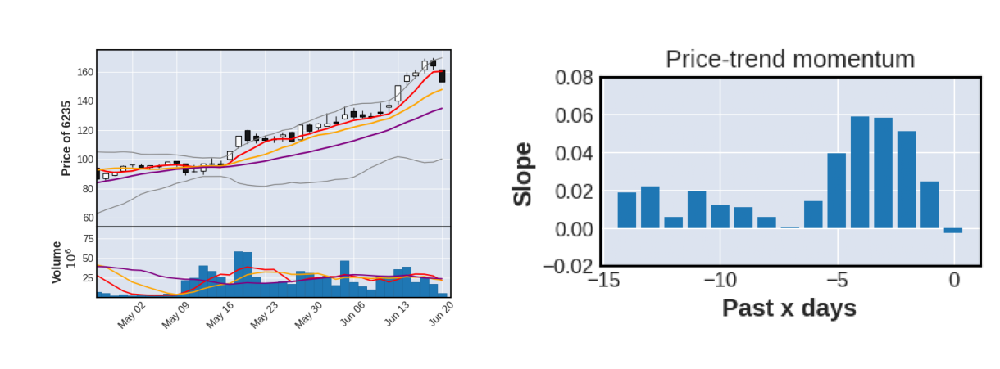

6187, ['萬潤', 398, 'meh', 'CoWoS產能將倍增 四檔最補']


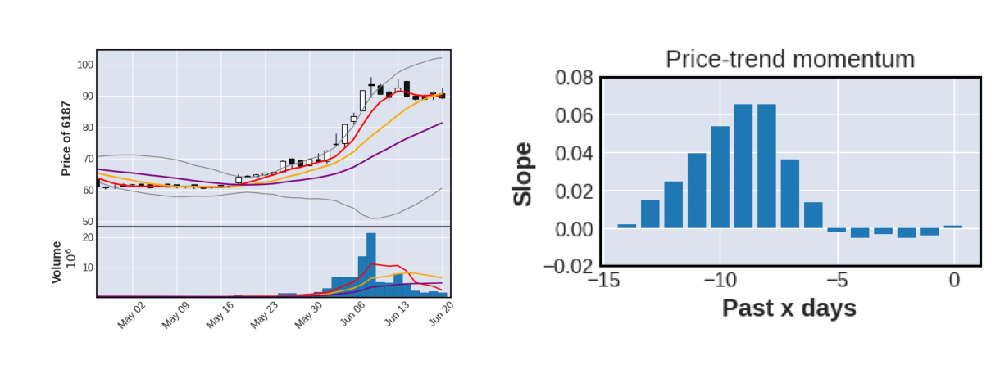

5465, ['富驊', 68, 'focus', '新品明年Q1出貨']


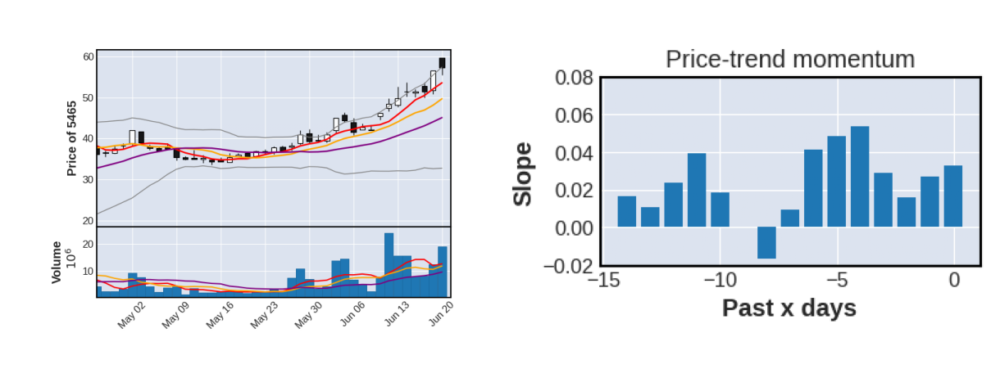

5258, ['虹堡', 53, 'focus', 'nan']


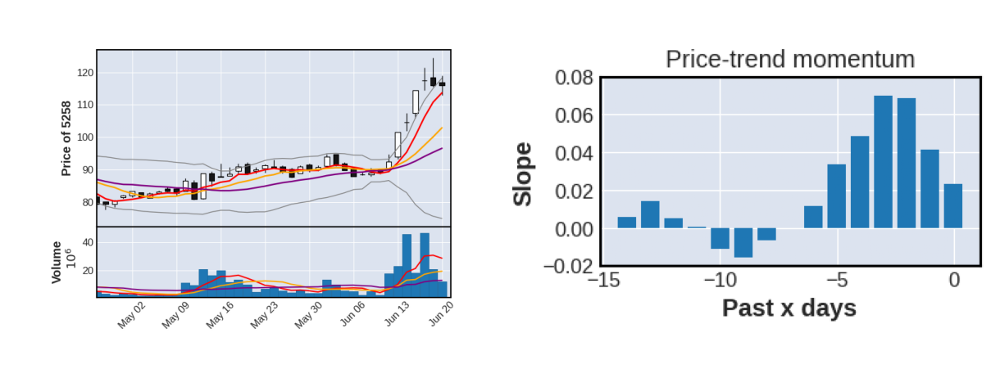

3711, ['日月光投控', 61, 'meh', 'CoWoS產能將倍增 四檔最補']


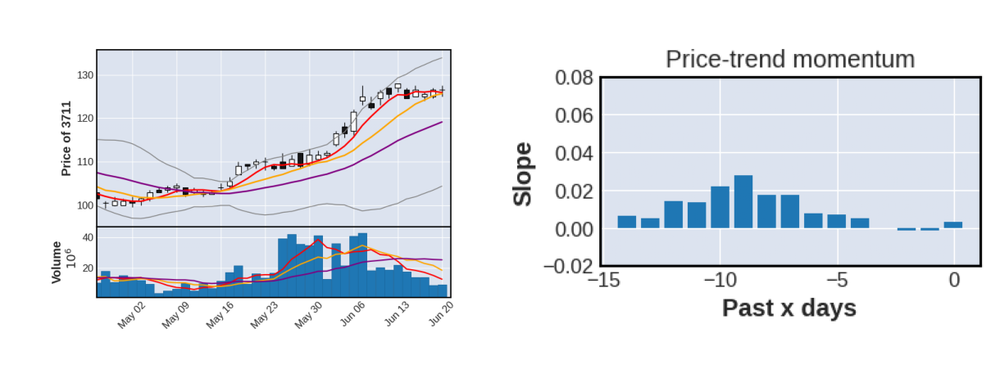

3617, ['碩天', 321, 'meh', '碩天出貨唱旺 今年雙成長可期']


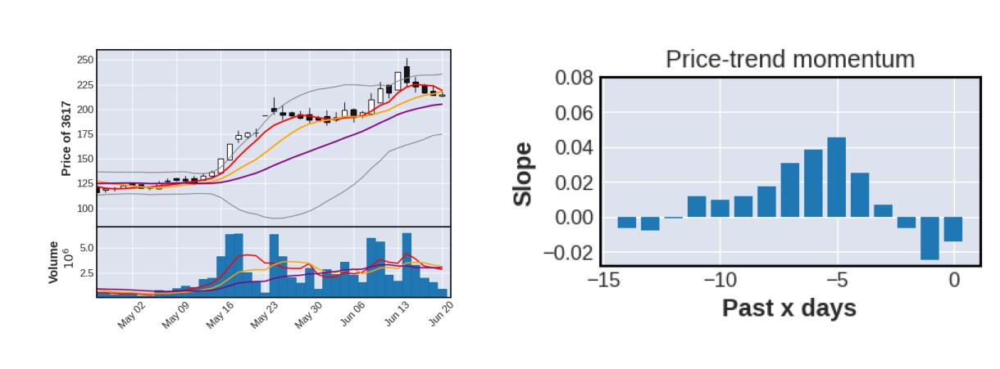

3583, ['辛耘', 93, 'holding', 'CoWoS產能將倍增 四檔最補']


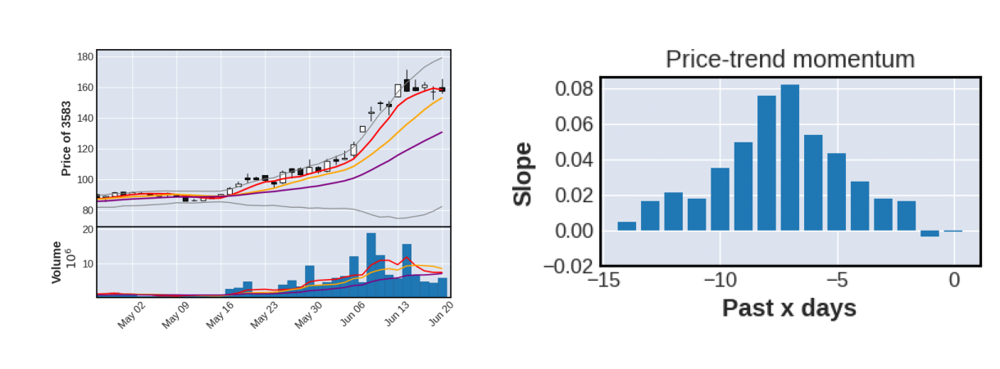

3308, ['聯德', 620, 'holding', 'nan']


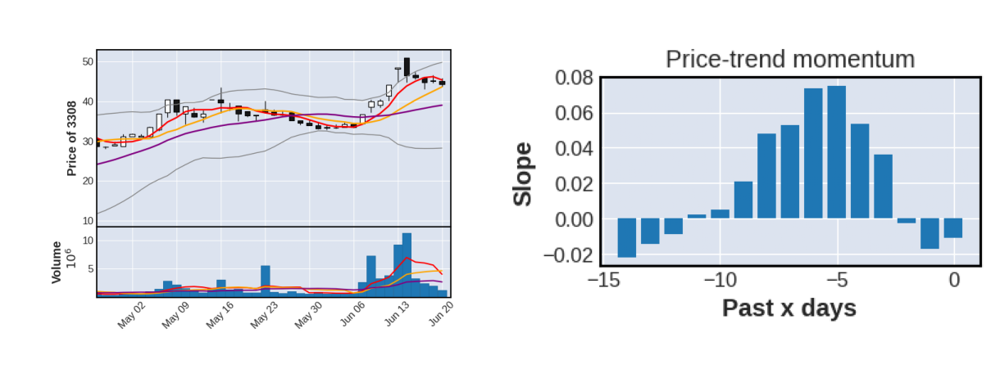

3231, ['緯創', 2, 'holding', 'nan']


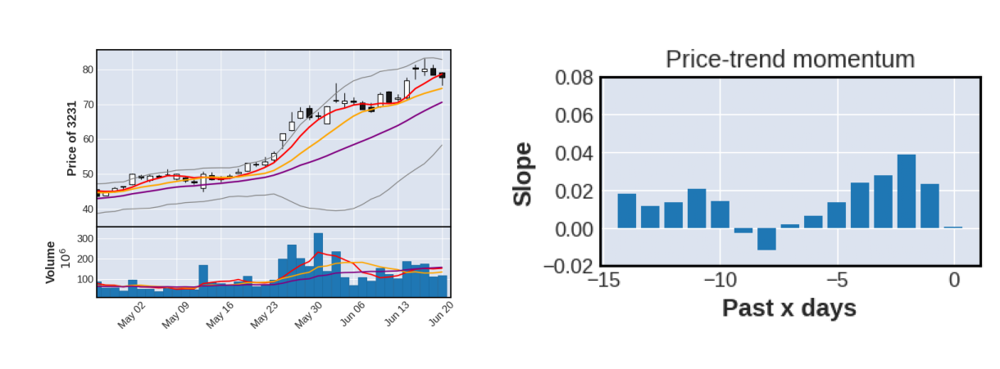

3131, ['弘塑', 239, 'meh', 'CoWoS產能將倍增 四檔最補']


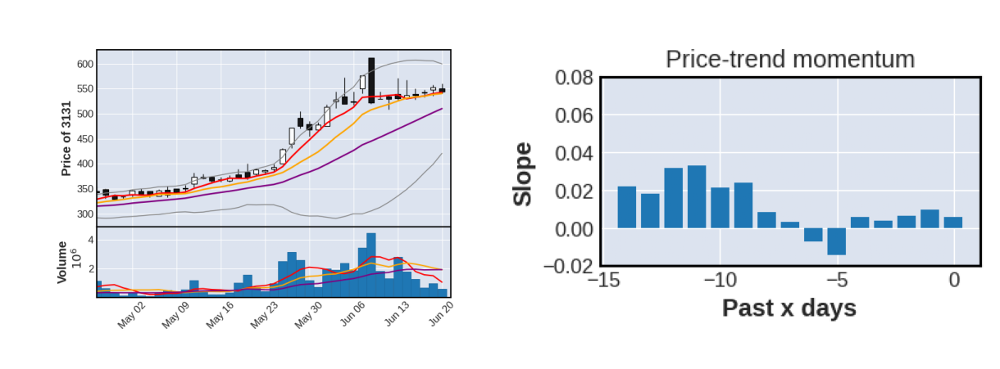

3078, ['僑威', 56, 'focus', 'nan']


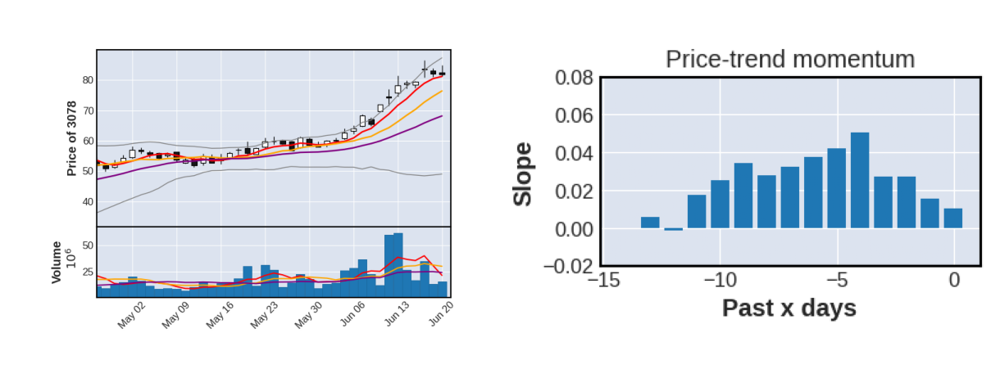

3046, ['建碁', 221, 'holding', 'nan']


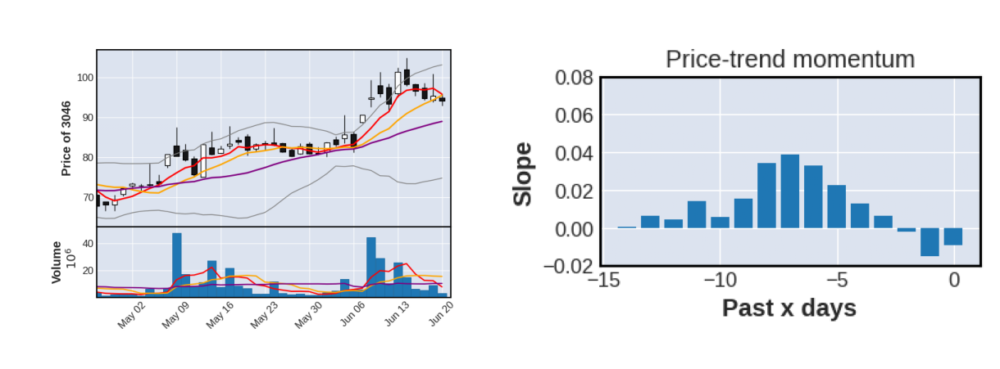

3034, ['聯詠', 54, 'meh', 'nan']


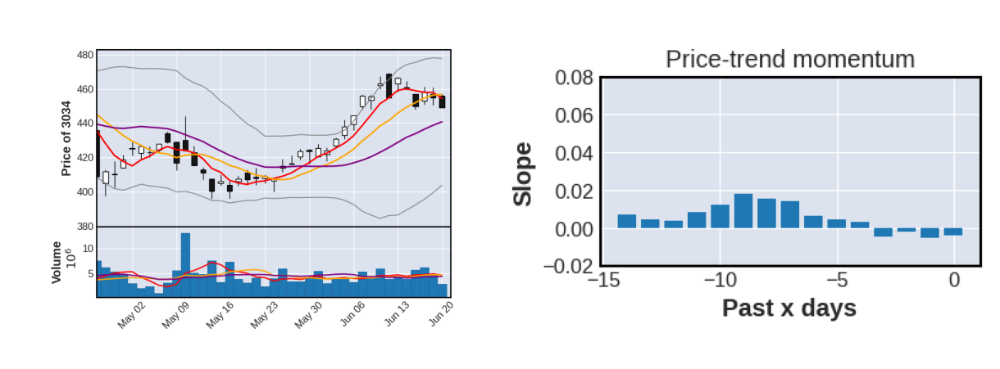

3017, ['奇鋐', 15, 'focus', 'nan']


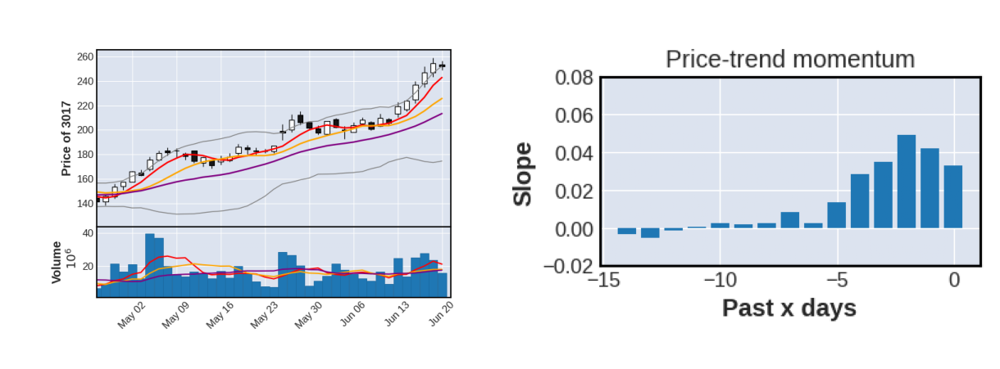

2745, ['五福', 701, 'meh', 'nan']


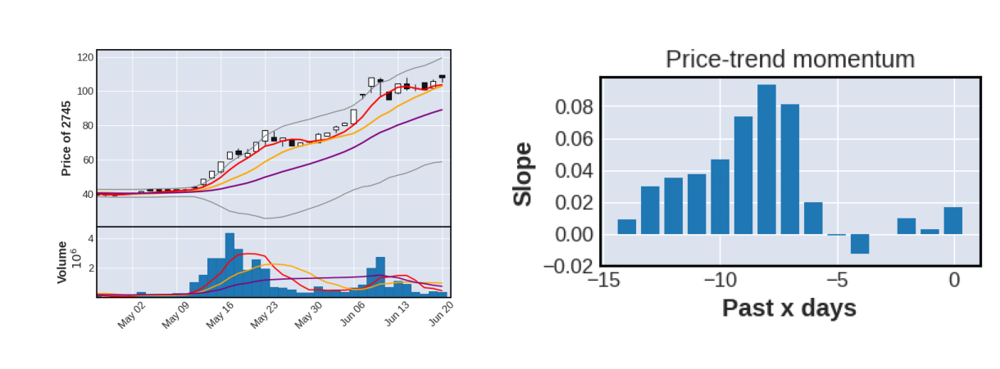

2743, ['山富', 618, 'focus', 'nan']


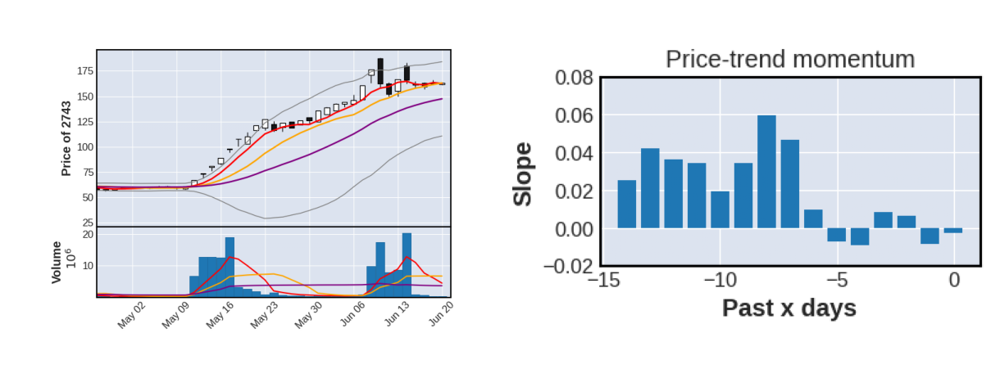

2734, ['易飛網', 514, 'focus', 'nan']


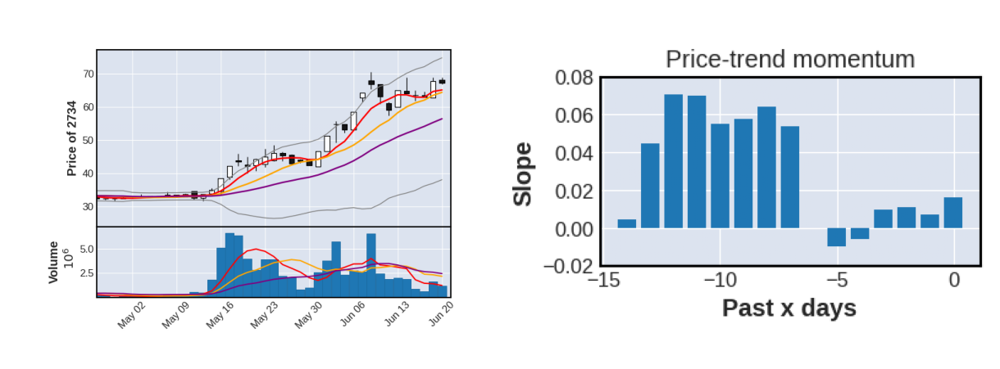

2401, ['凌陽', 283, 'focus', 'nan']


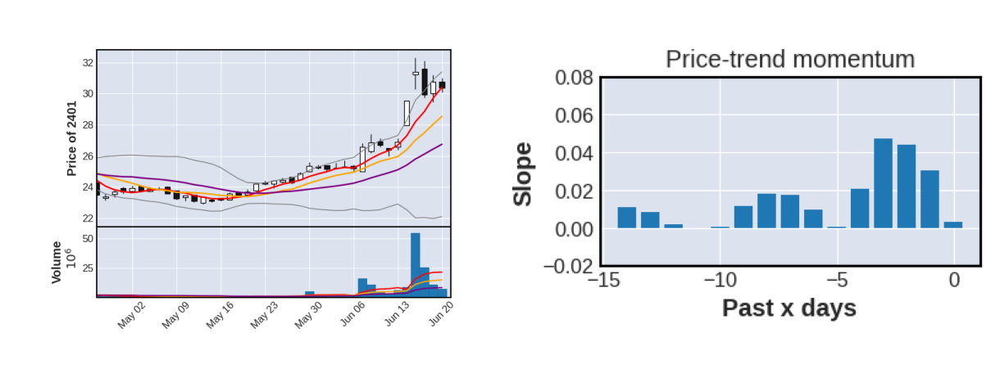

2395, ['研華', 192, 'focus', 'nan']


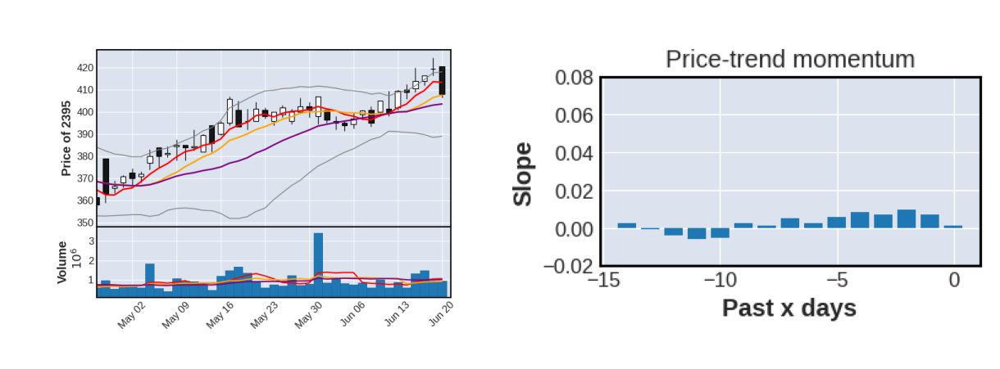

2382, ['廣達', 3, 'holding', 'nan']


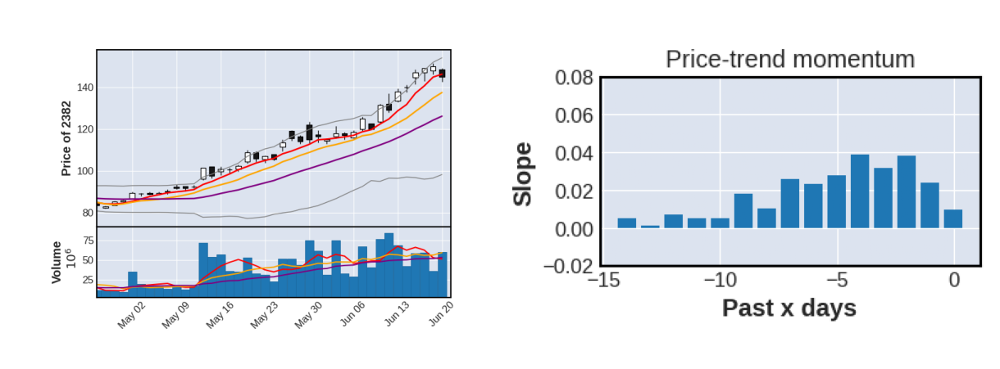

2377, ['微星', 114, 'meh', 'nan']


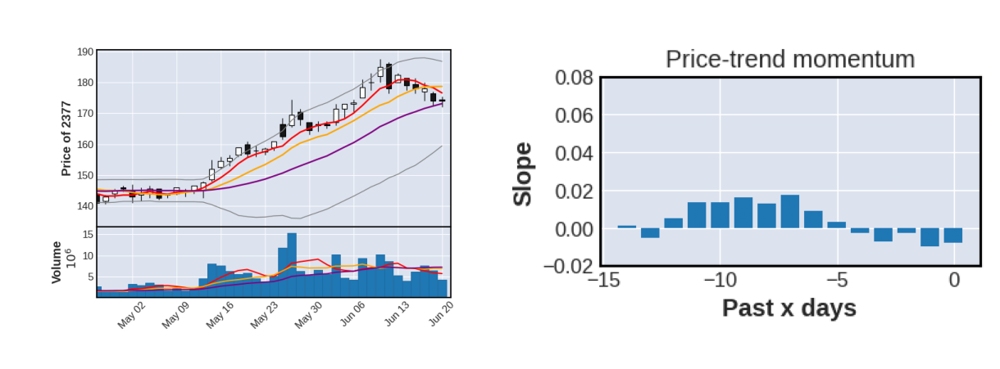

2376, ['技嘉', 10, 'holding', 'nan']


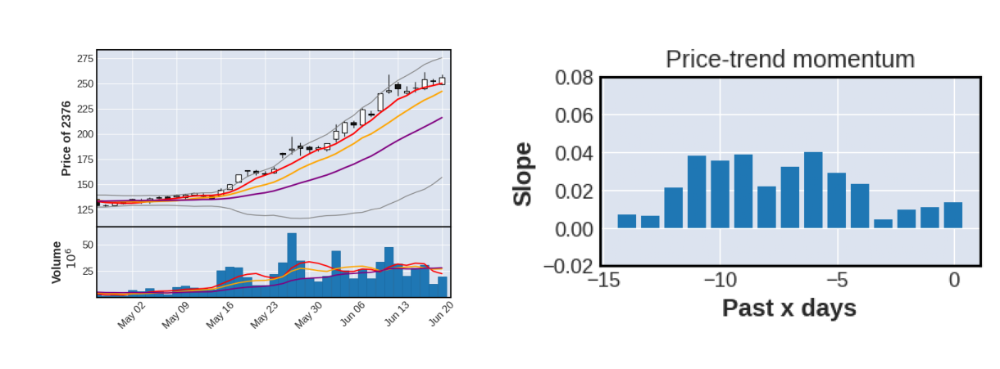

2371, ['大同', 6, 'focus', 'nan']


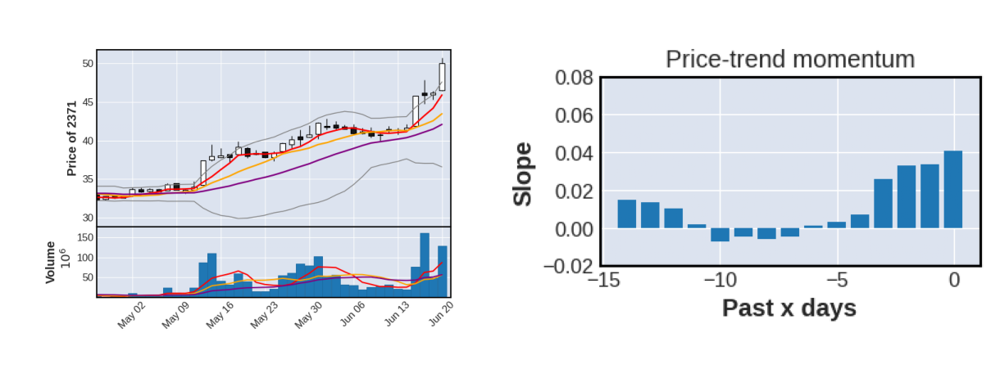

2356, ['英業達', 22, 'holding', 'AI伺服器出貨 「明年大成長」']


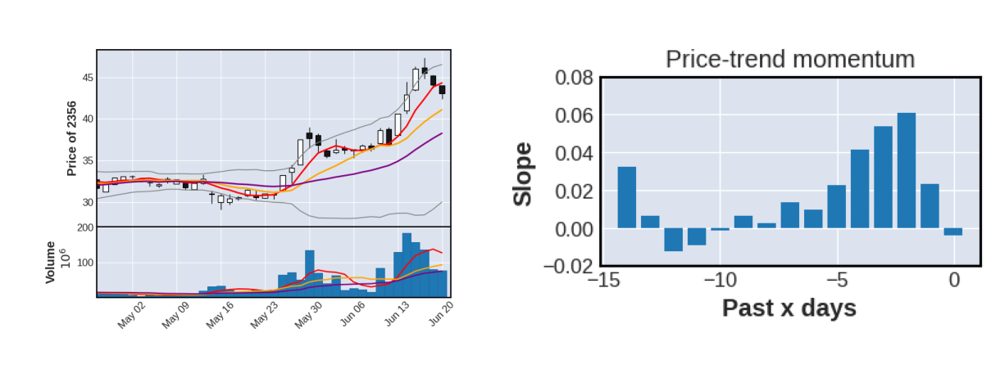

2352, ['佳世達', 106, 'holding', 'nan']


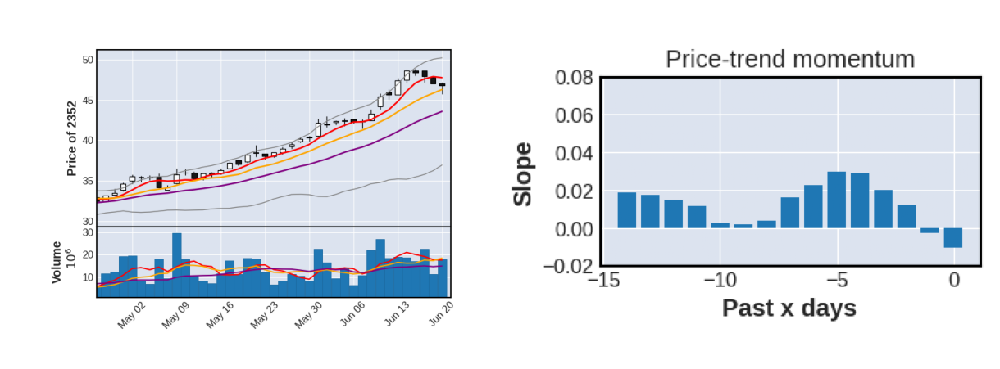

2206, ['三陽工業', 32, 'focus', 'nan']


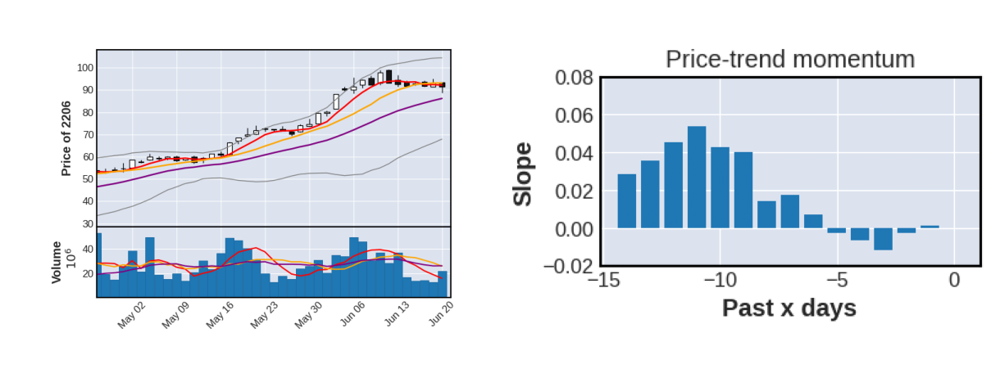

1504, ['東元', 31, 'meh', 'nan']


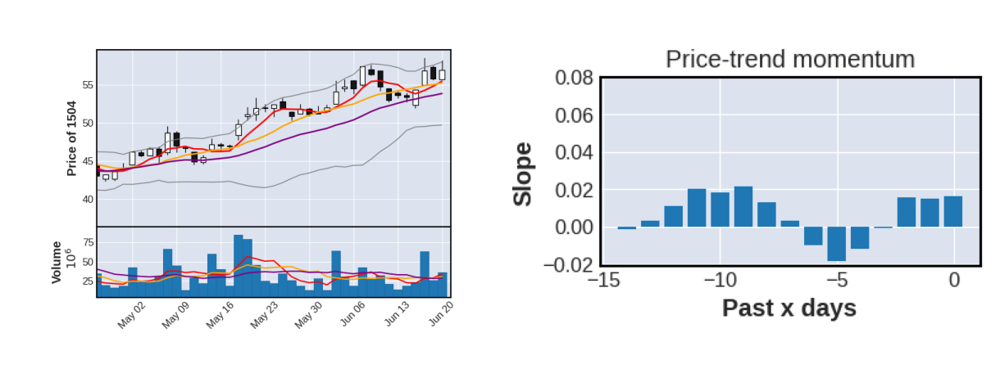

3515, ['華擎', 73, 'focus', 'AMD 單有可能下這裡']


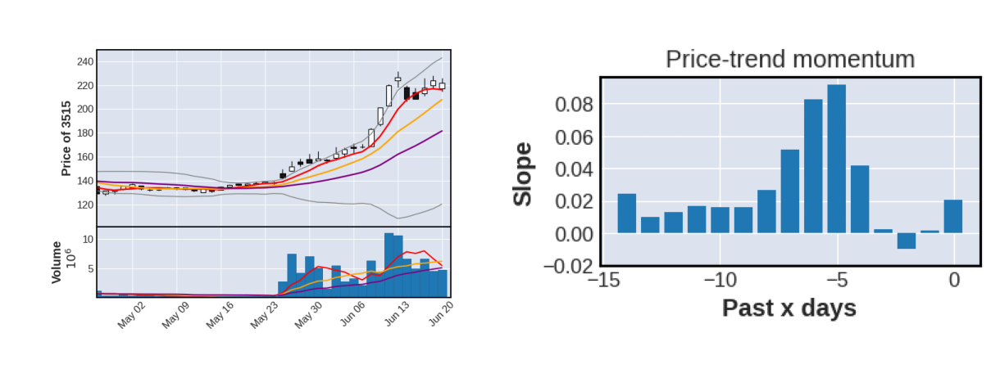

In [ ]:
display_analysis(list(focus_dict.keys()), focus_dict, detail_dict)

# Start analysis

In [ ]:
# The dictionary that will be used to store all the ranking info below
final_ranking = dict()

## High potential: Extreme volume with high changes
- Stock that attracted a lot of investors in a short time. Have high potential.

In [ ]:
# Change chosen_data to quickly change the analysed target stock lists
chosen_data = tw_dict

volume = {5: [],
          10: [],
          20: []}

for k in chosen_data.keys():
  # Limit price to below 400k
  if chosen_data[k].iloc[-1]["Close"] < 400 and chosen_data[k].iloc[-1]["InDayChg"] > 3:
    # Duplicates are acceptable in this section
    if chosen_data[k].iloc[-1]["relVMA20"] > 2:
      volume[20].append(k)
    if chosen_data[k].iloc[-1]["relVMA10"] > 2:
      volume[10].append(k)
    if chosen_data[k].iloc[-1]["relVMA5"] > 2:
      volume[5].append(k)

print(len(volume[5]), len(volume[10]), len(volume[20]))

34 36 43


In [ ]:
final_ranking = add_ranking(list(set(volume[5] + volume[10])), final_ranking, "volume")

3564, ['其陽', 375]


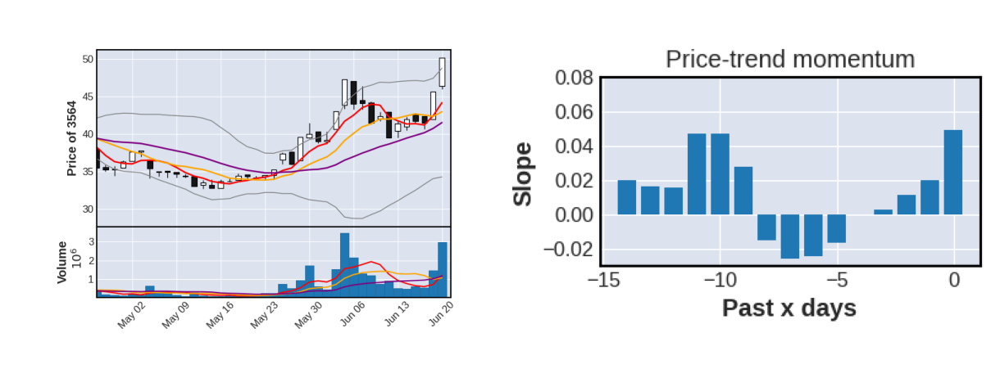

3202, ['樺晟', 475]


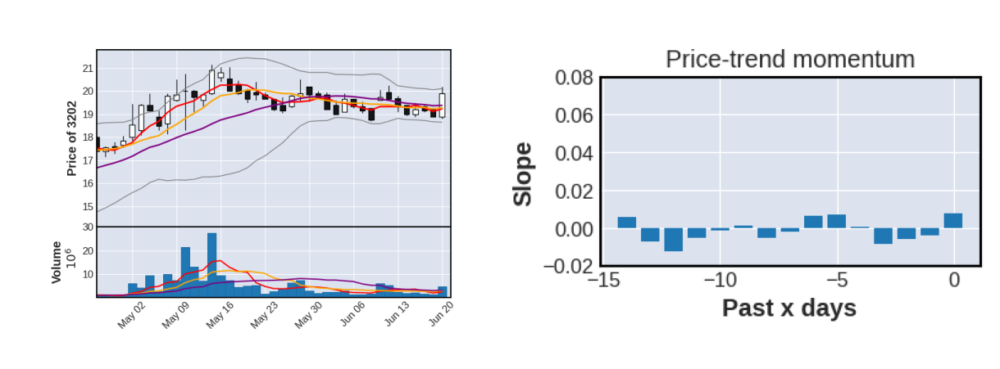

6120, ['達運', 155]


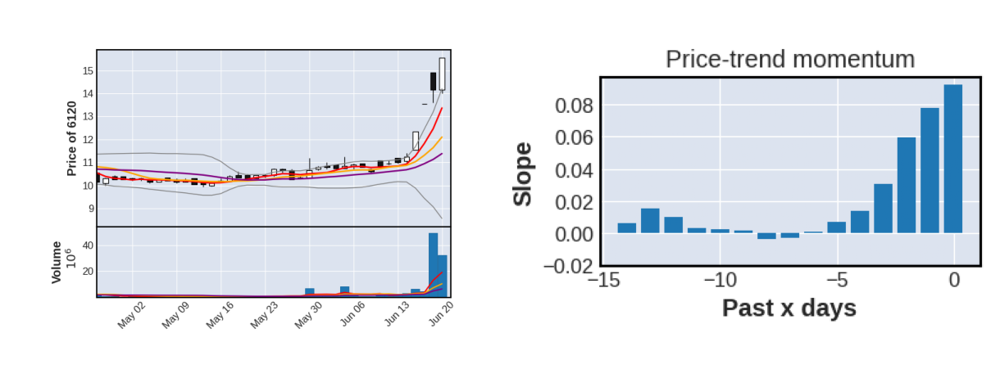

2755, ['揚秦', 462]


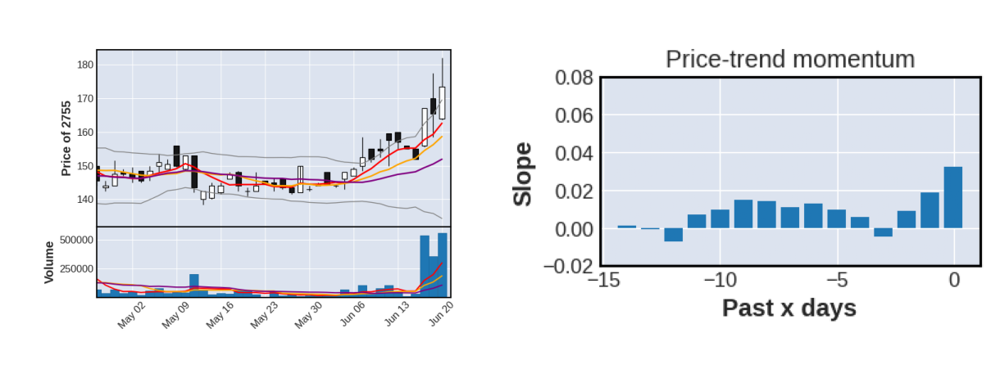

4747, ['強生', 208]


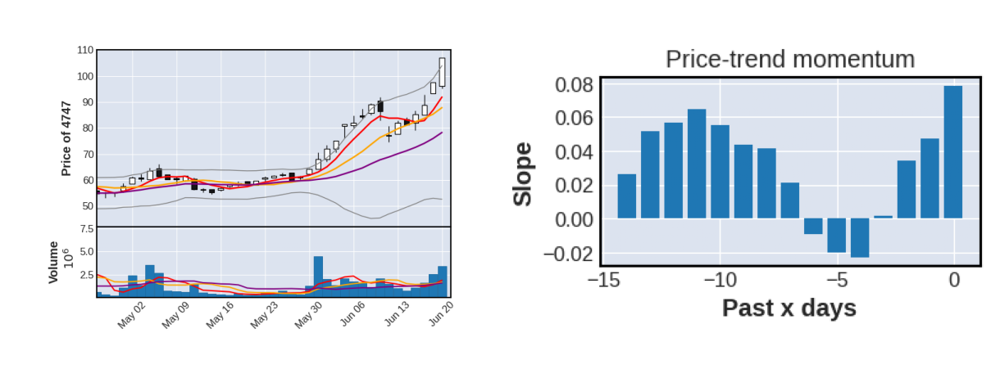

4108, ['懷特', 470]


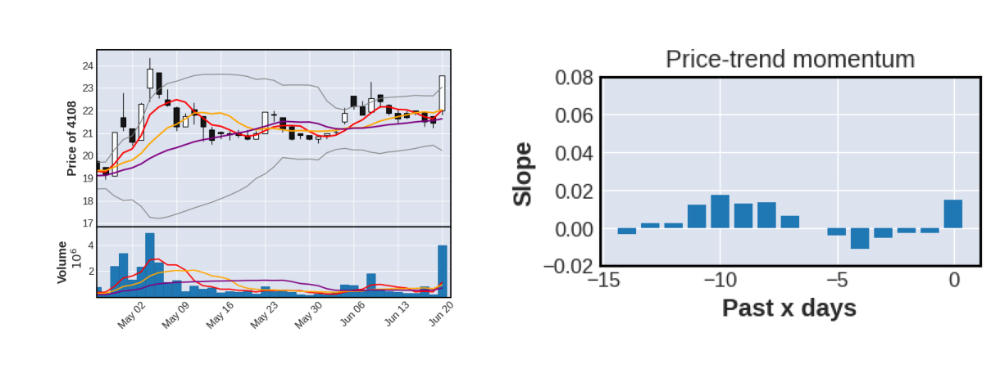

6462, ['神盾', 178]


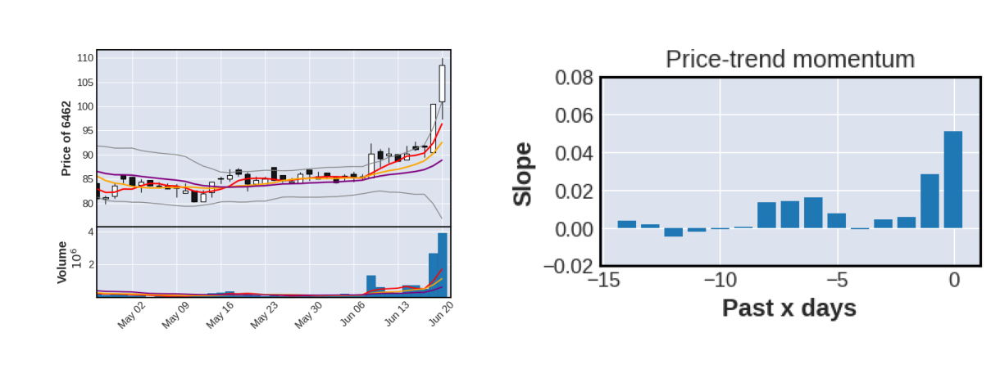

4916, ['事欣科', 71]


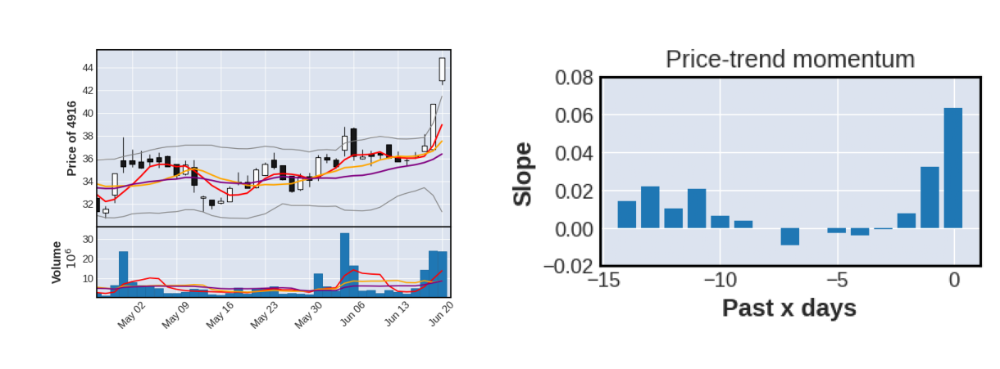

6217, ['中探針', 77]


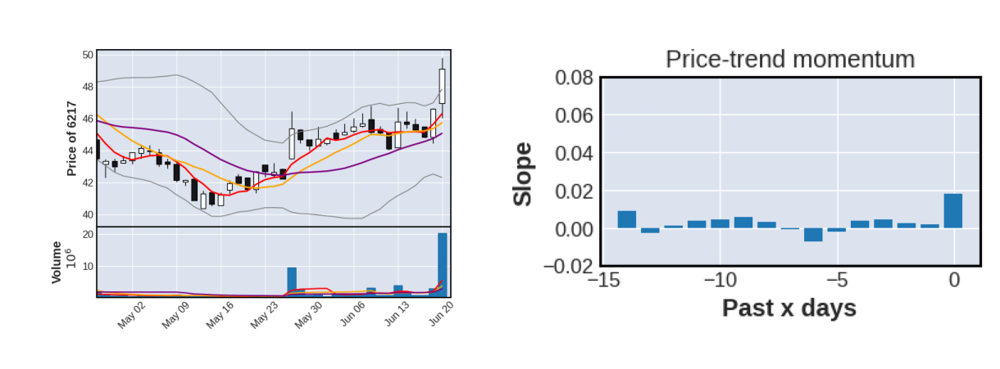

6164, ['華興', 756]


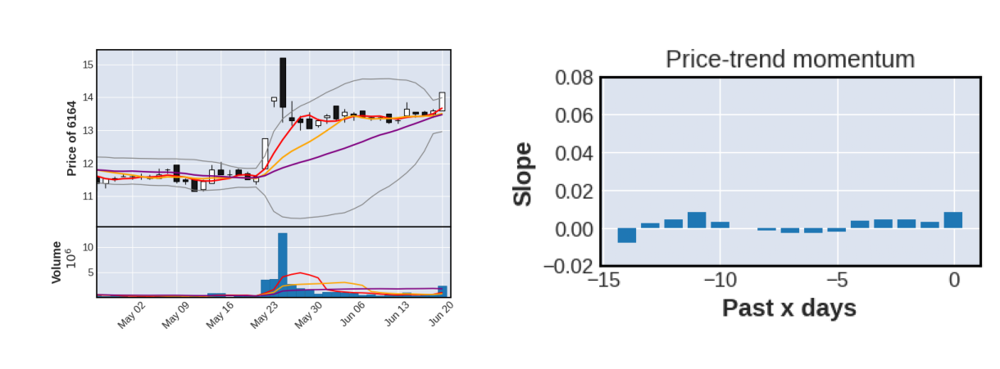

6695, ['芯鼎', 499]


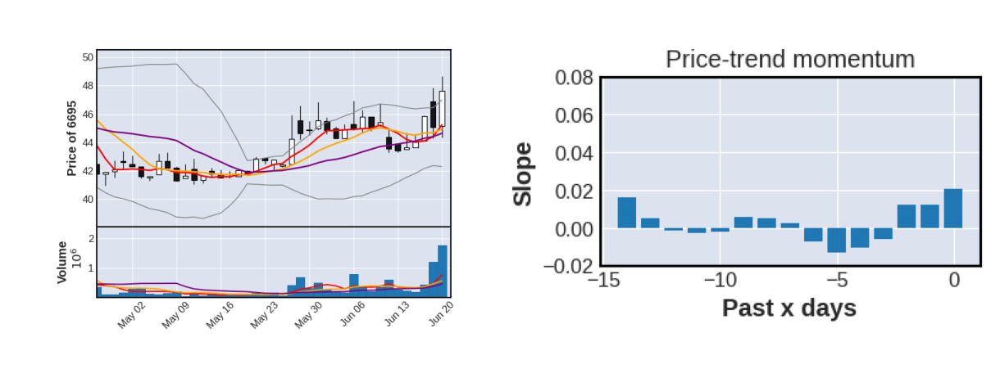

5364, ['力麗店', 898]


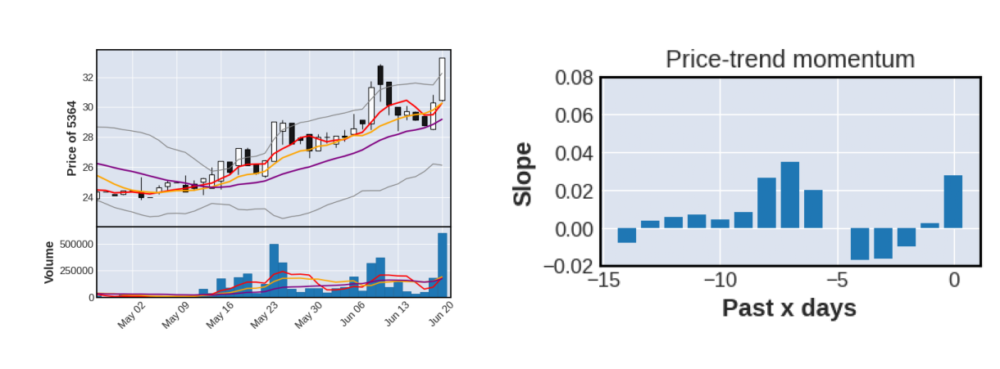

3611, ['鼎翰', 561]


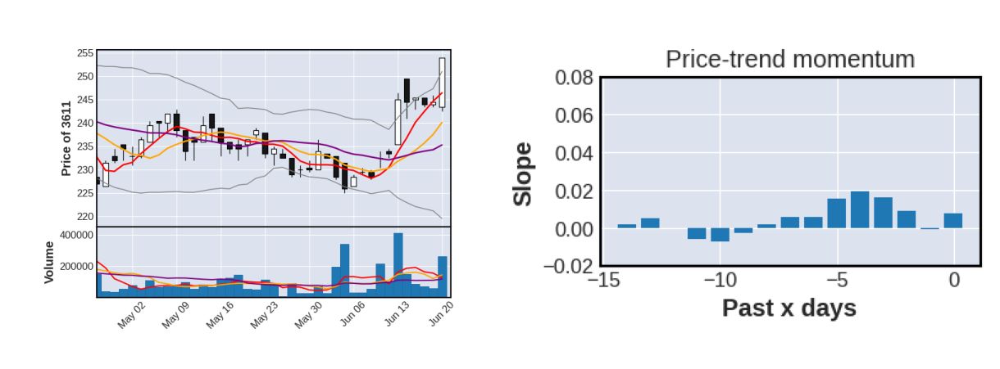

5704, ['老爺知', 131]


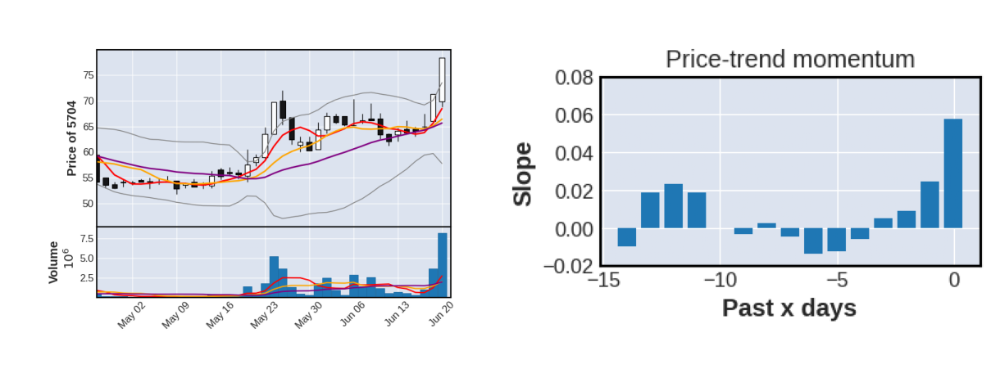

8249, ['菱光', 821]


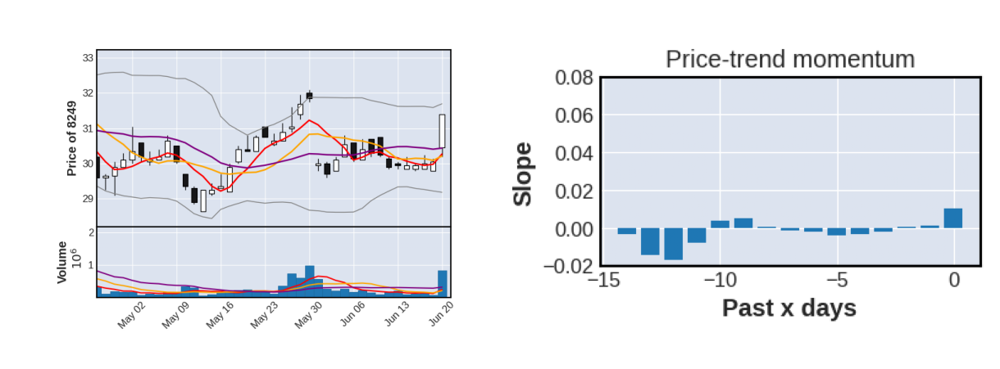

5905, ['南仁湖', 228]


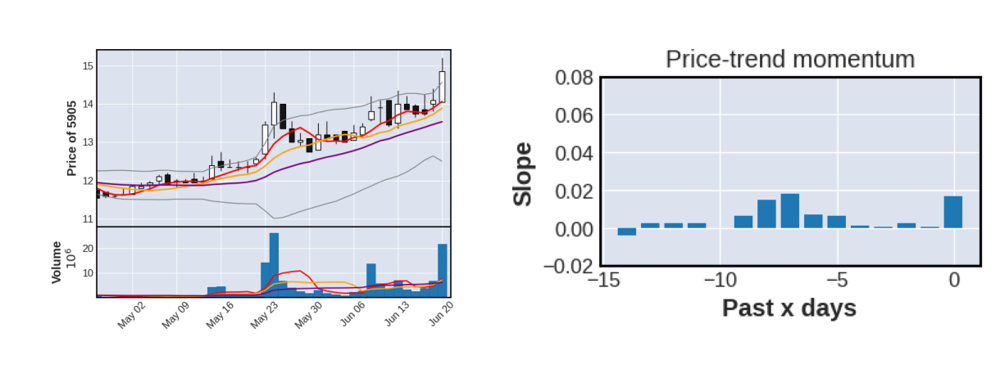

1612, ['宏泰', 150]


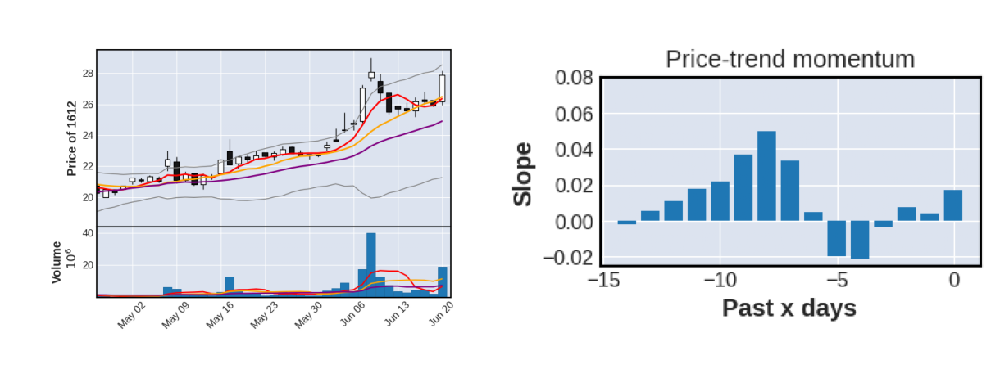

6584, ['南俊國際', 459]


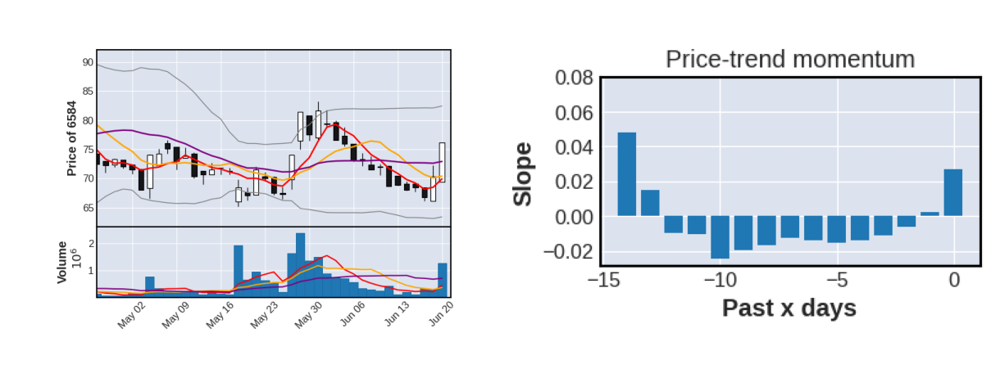

3687, ['歐買尬', 130]


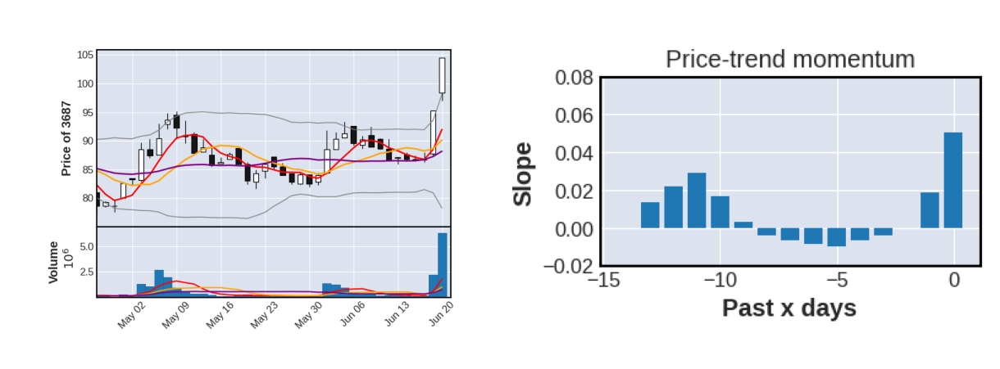

3205, ['佰研', 589]


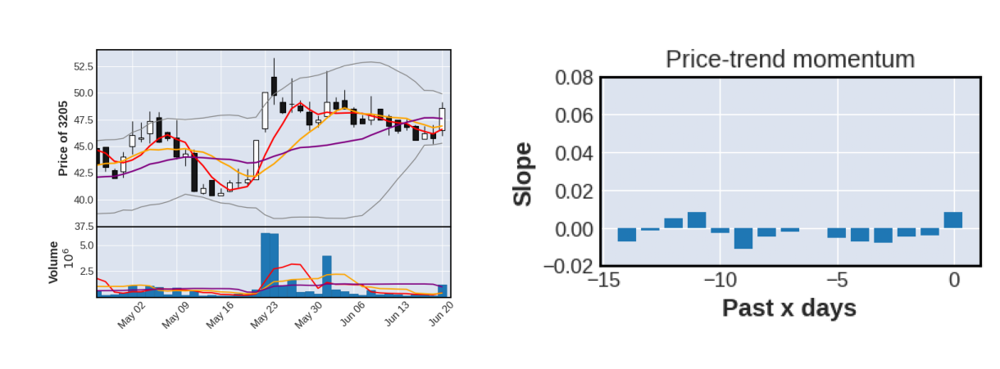

1471, ['首利', 363]


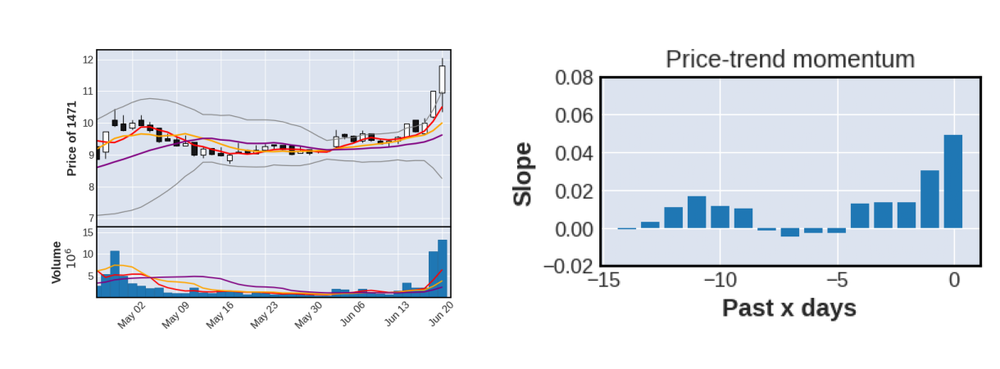

6290, ['良維', 88]


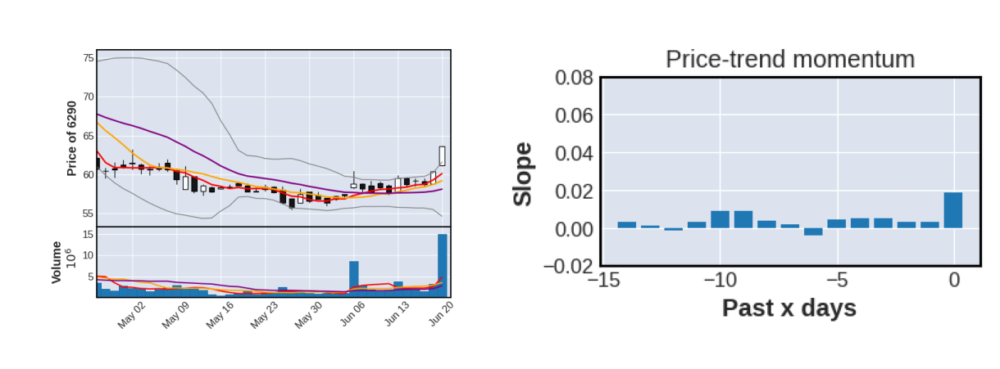

3581, ['博磊', 565]


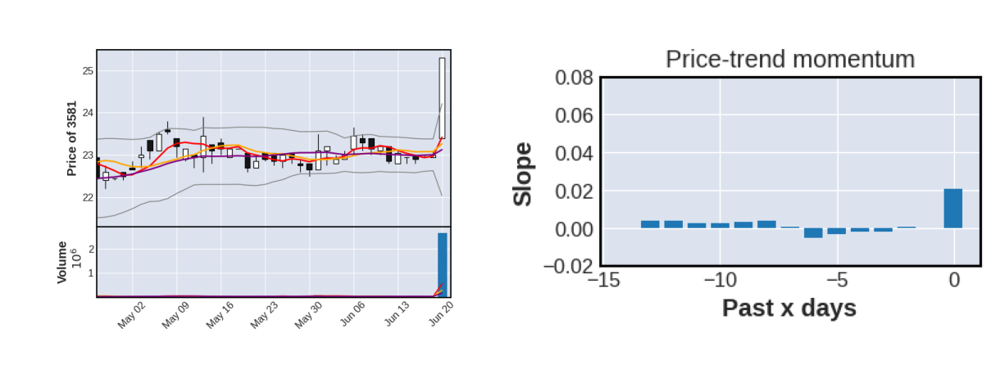

3089, ['億杰', 777]


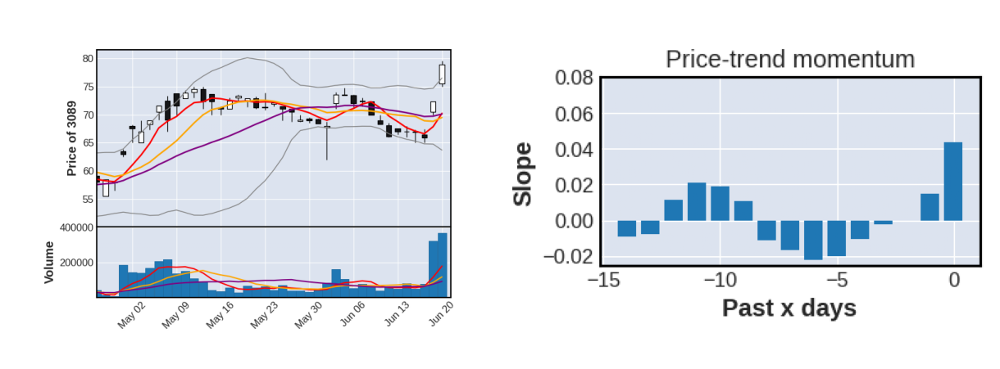

3252, ['海灣', 148]


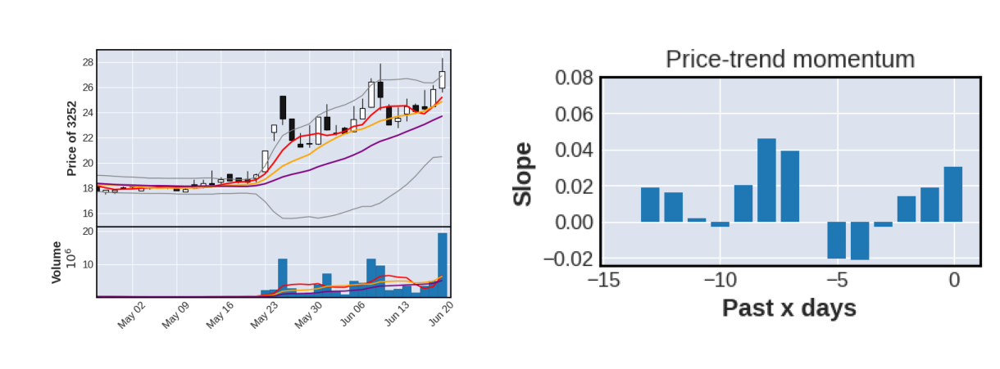

4549, ['桓達', 344]


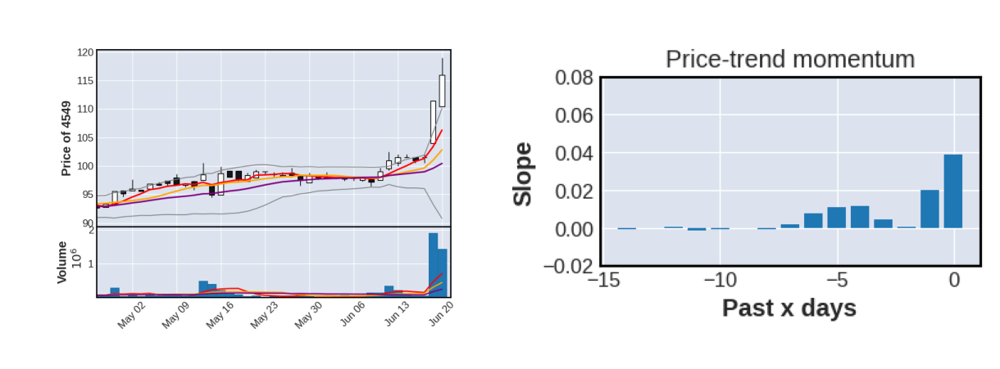

4991, ['環宇-KY', 942]


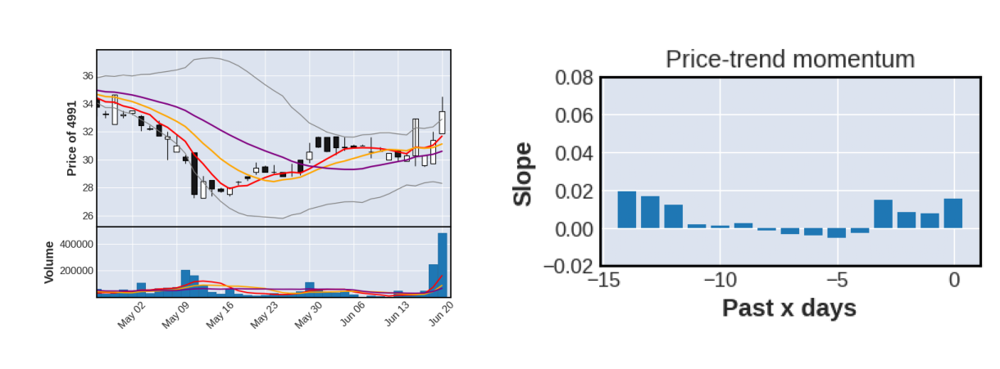

2748, ['雲品', 14]


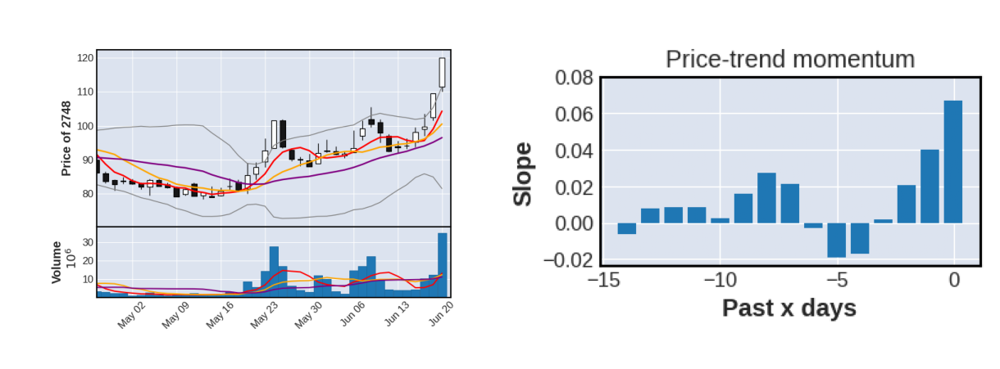

6111, ['大宇資', 44]


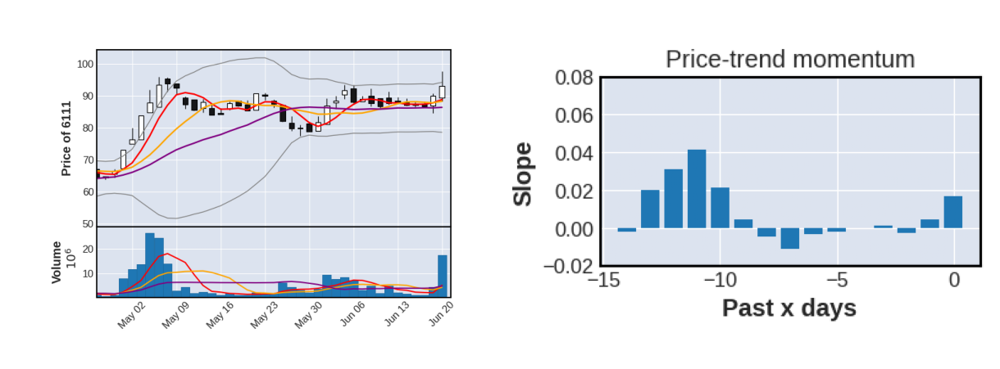

6244, ['茂迪', 89]


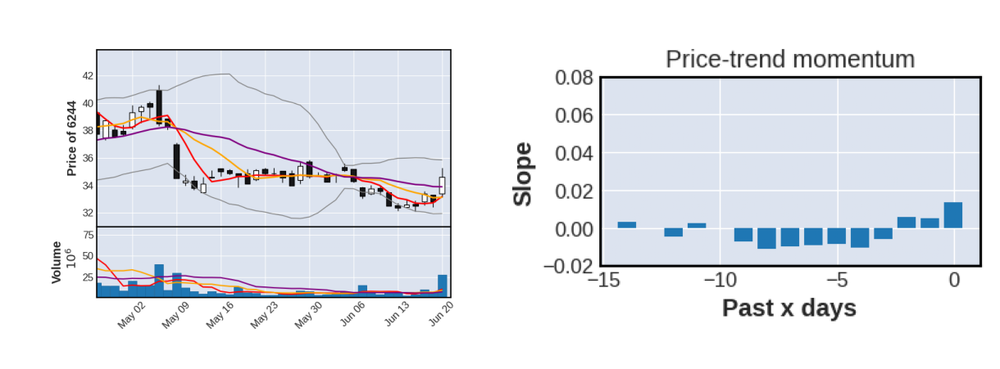

2739, ['寒舍', 170]


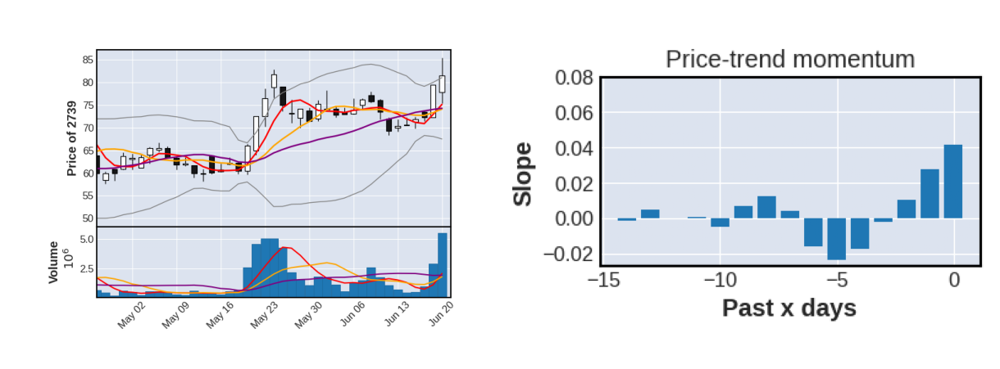

4934, ['太極', 310]


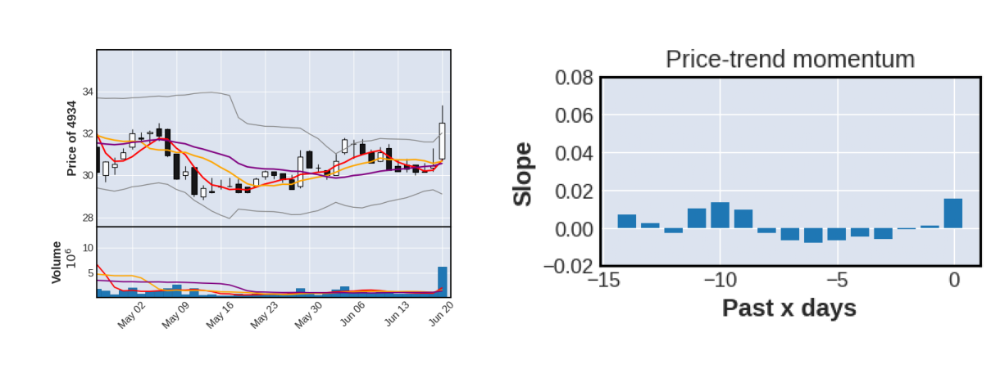

2371, ['大同', 6, 'focus', 'nan']


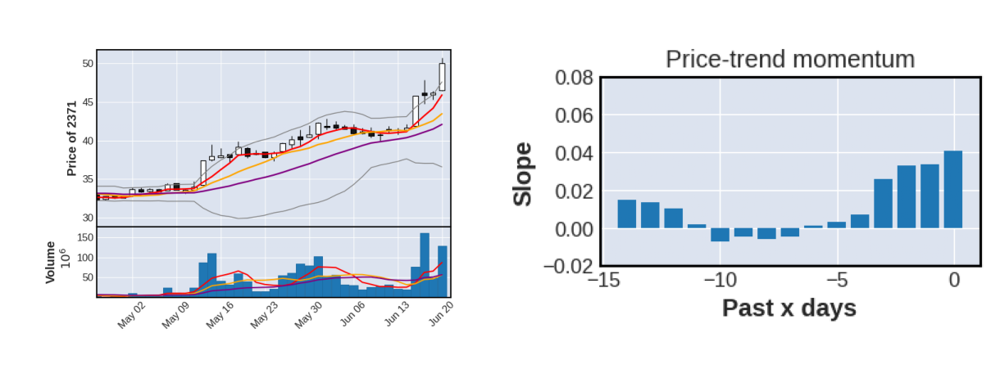

2712, ['遠雄來', 328]


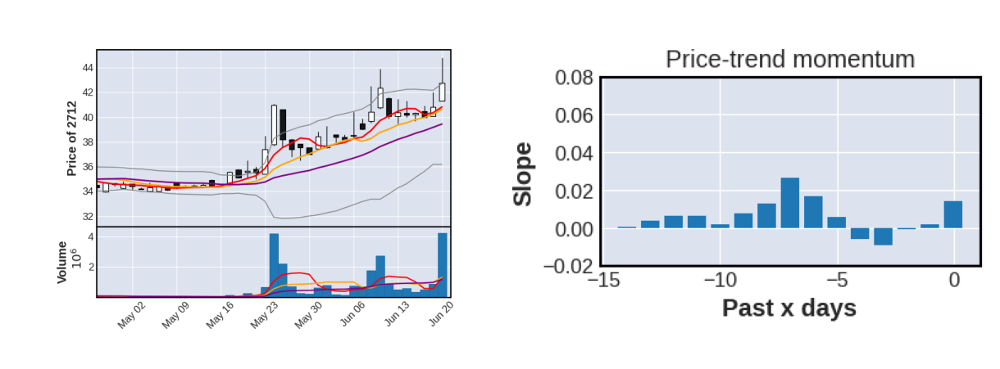

2702, ['華園', 247]


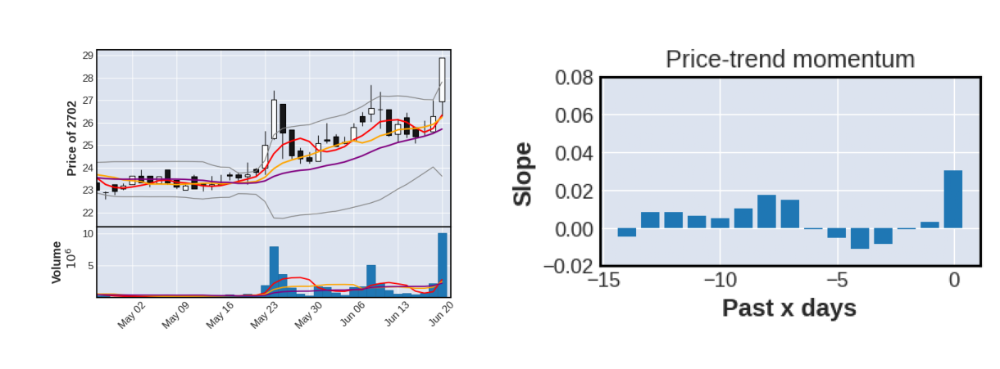

5484, ['慧友', 703]


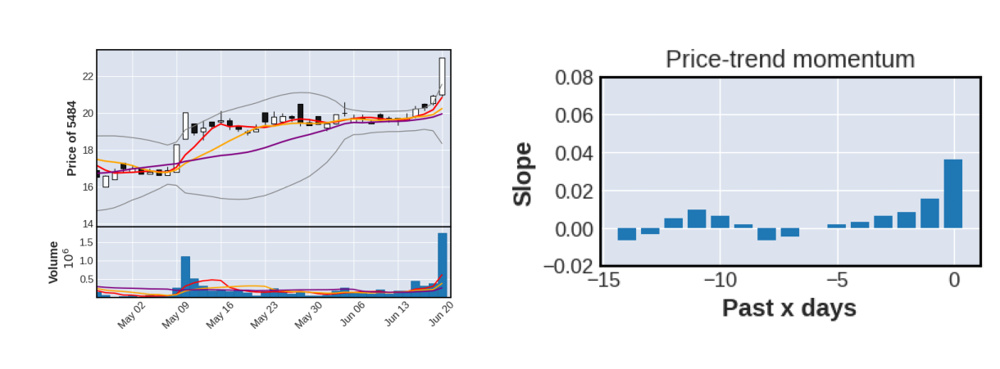

1337, ['再生-KY', 562]


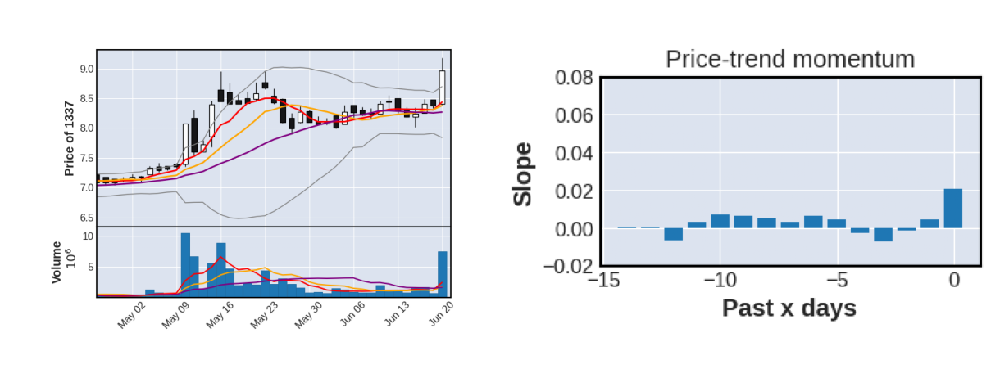

2017, ['官田鋼', 425]


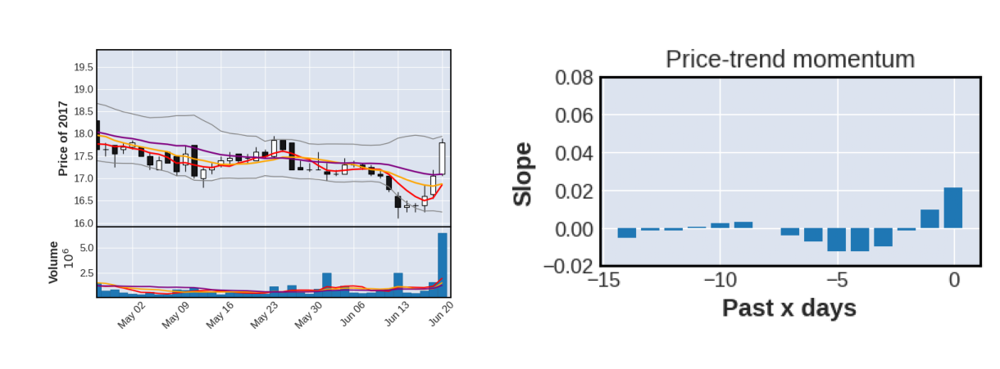

2706, ['第一店', 276]


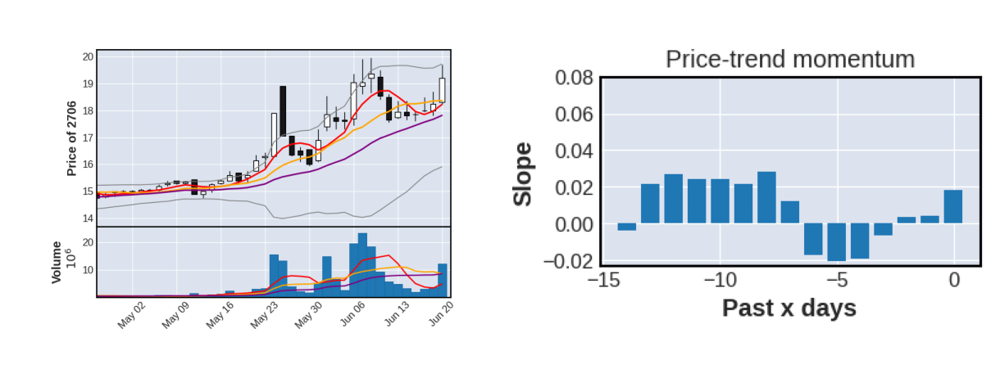

6854, ['錼創科技-KY創', 515]


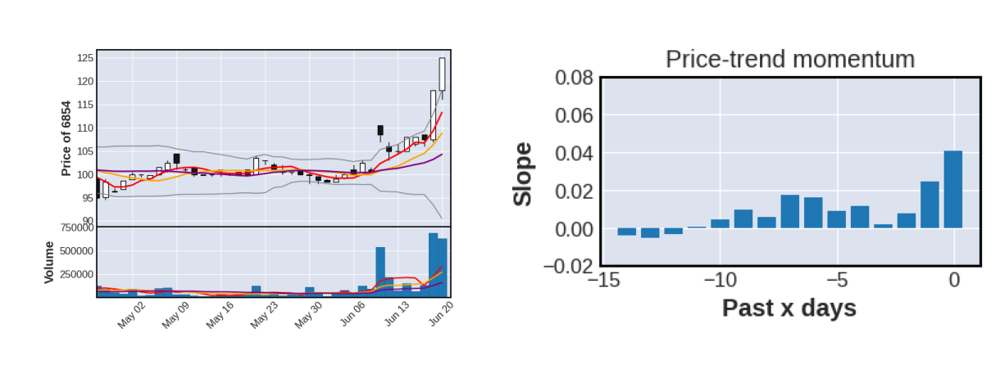

In [ ]:
display_analysis(list(set(volume[5] + volume[10])), chosen_data, detail_dict)

## High potential: 10ma continuously growing
- Use this on full ticker lists to look for potential stocks (russell, s&p500...)
- Very strict constraint, stocks shown here have high potential


In [ ]:
chosen_data = tw_dict

growth = {3: [],
          5: []}

for k in chosen_data.keys():
  diff = np.array(chosen_data[k][-19:]["MA10"]) - np.array(chosen_data[k][-20:-1]["MA10"])

  # Limit price to below 400k
  if chosen_data[k].iloc[-1]["Close"] < 400:
    if not np.any(diff < 0):
      # Save in order so there won't be duplicates
      if (diff[-5:] == sorted(diff[-5:])).all():
        growth[5].append(k)
      elif (diff[-3:] == sorted(diff[-3:])).all():
        growth[3].append(k)

print(len(growth[3]), len(growth[5]))

19 11


In [ ]:
final_ranking = add_ranking(growth[3] + growth[5], final_ranking, "10ma up")

3693, ['營邦', 19]


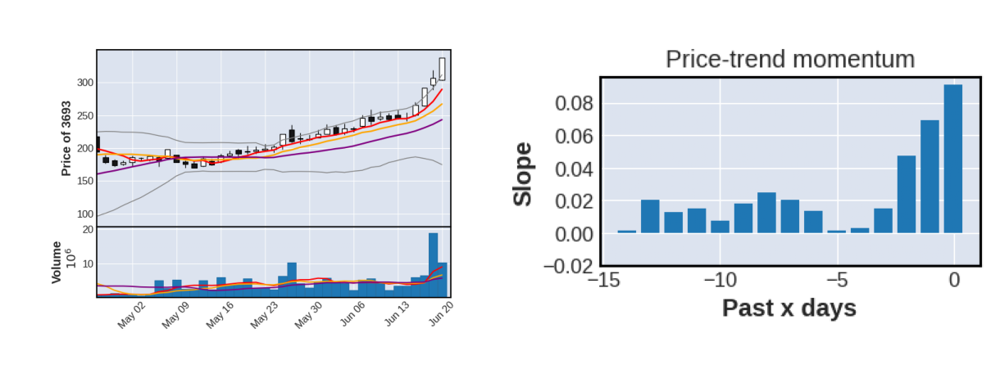

3260, ['威剛', 83]


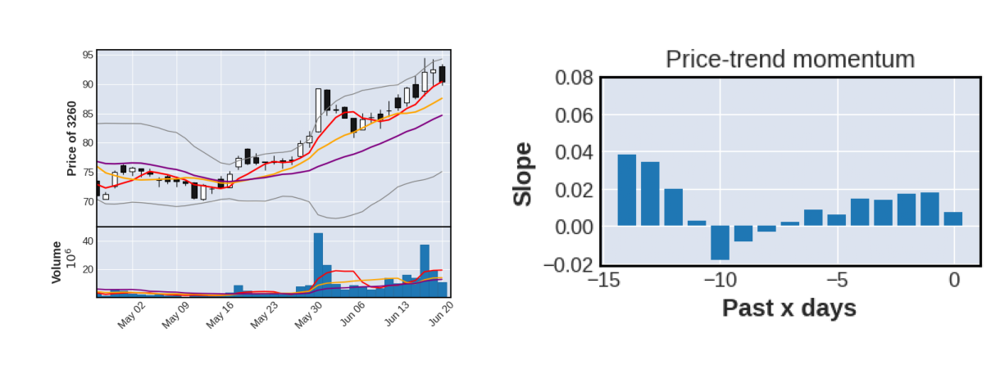

2722, ['夏都', 117]


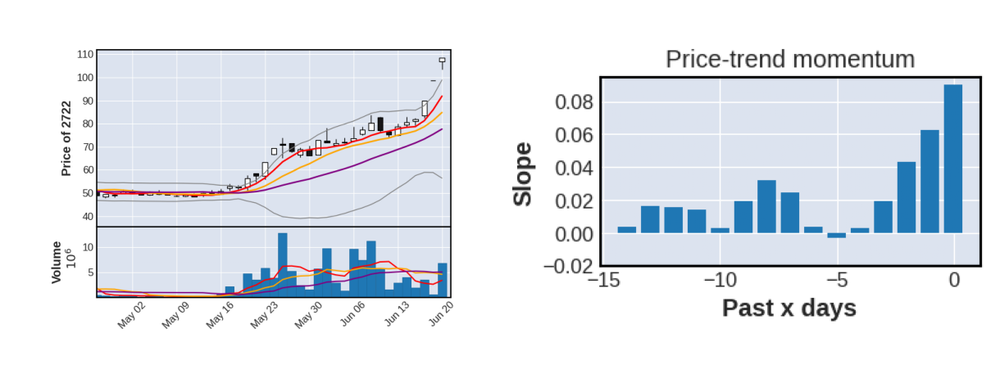

3665, ['貿聯-KY', 120]


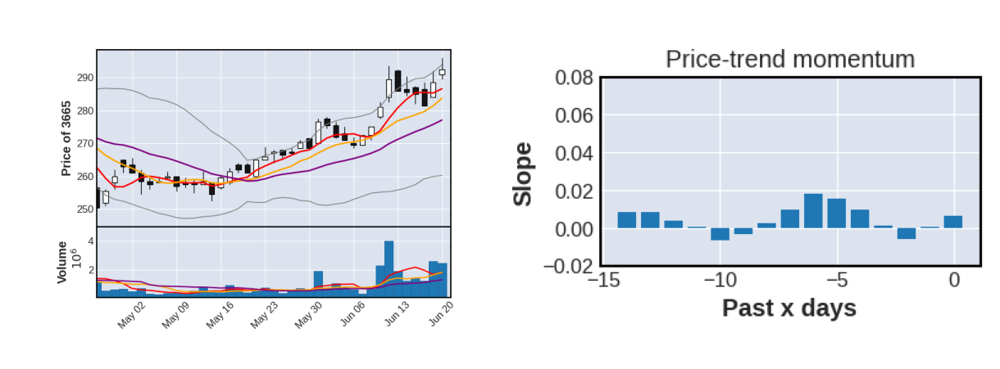

6203, ['海韻電', 140]


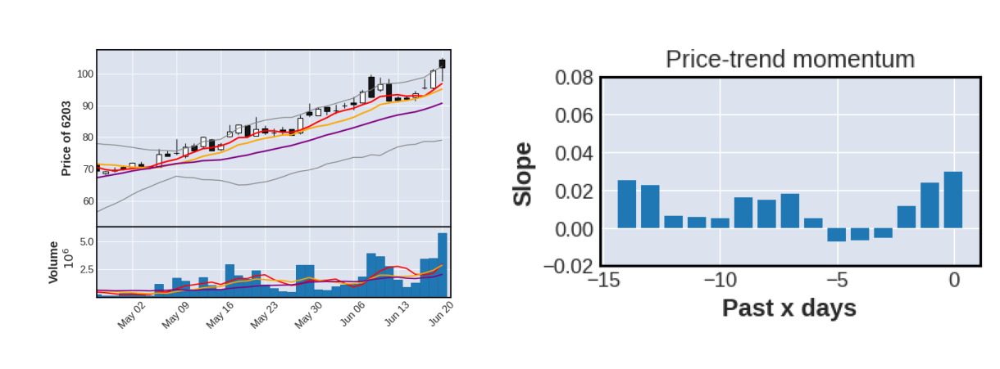

3252, ['海灣', 148]


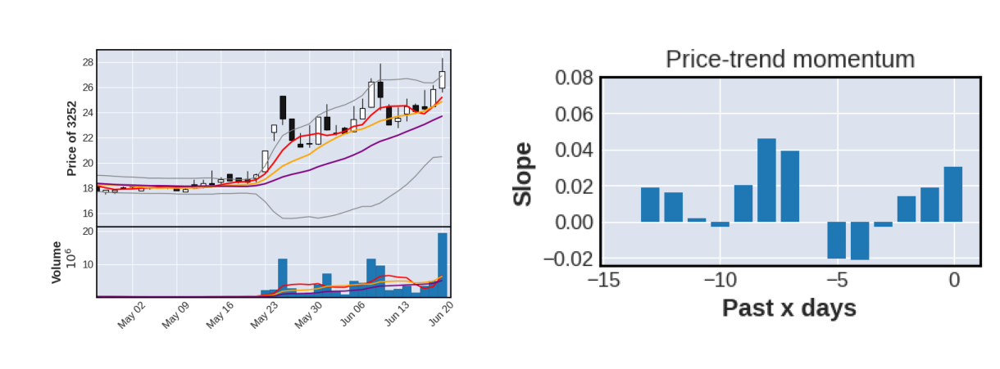

2736, ['富野', 157]


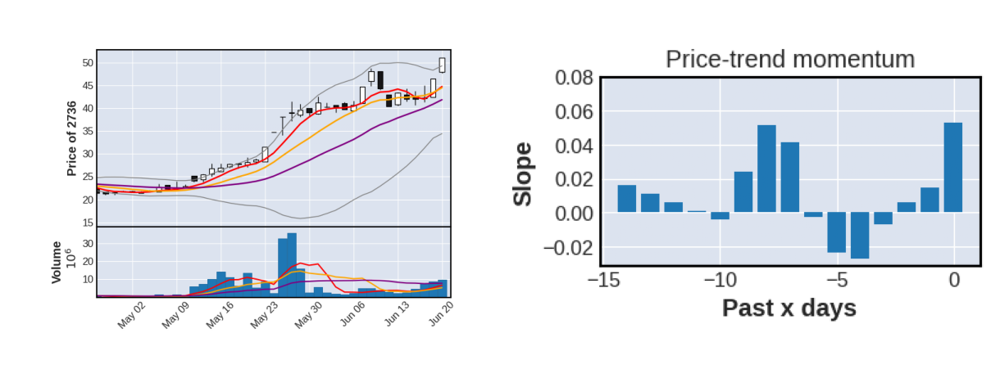

1103, ['嘉泥', 238]


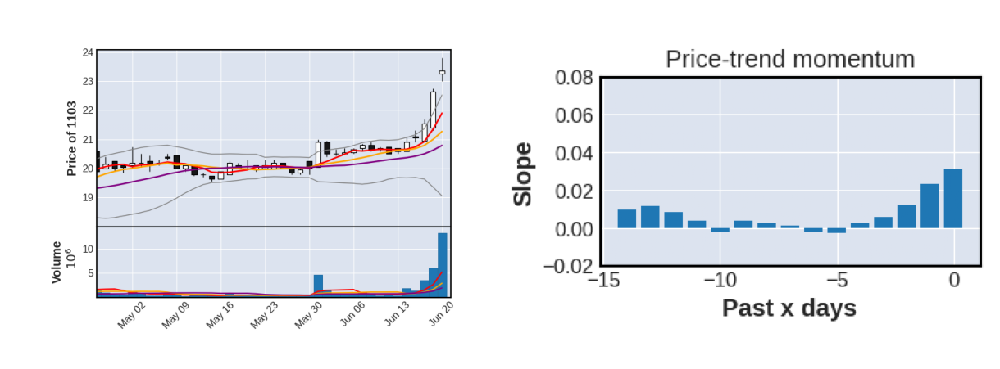

8940, ['新天地', 520]


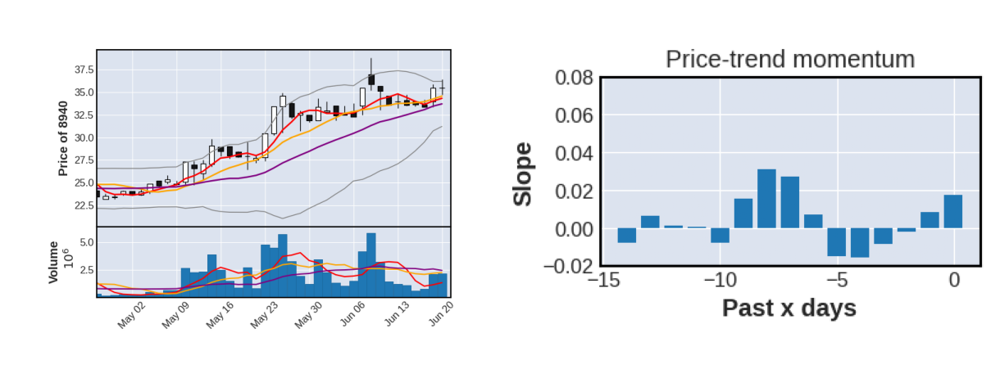

2236, ['百達-KY', 647]


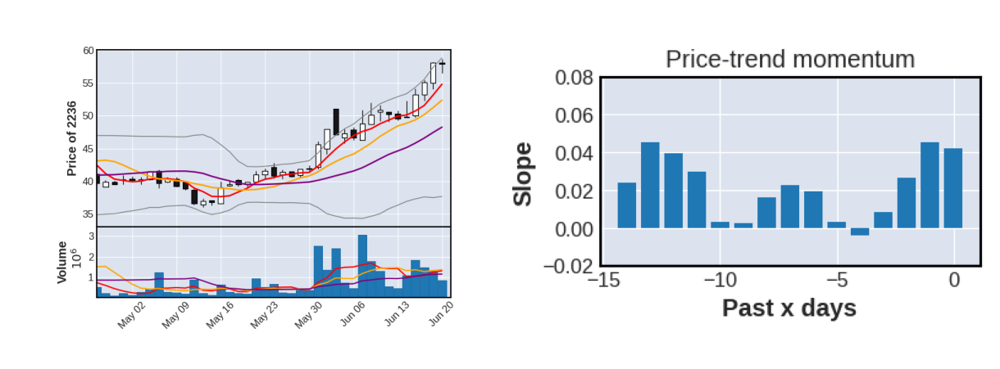

8024, ['佑華', 974]


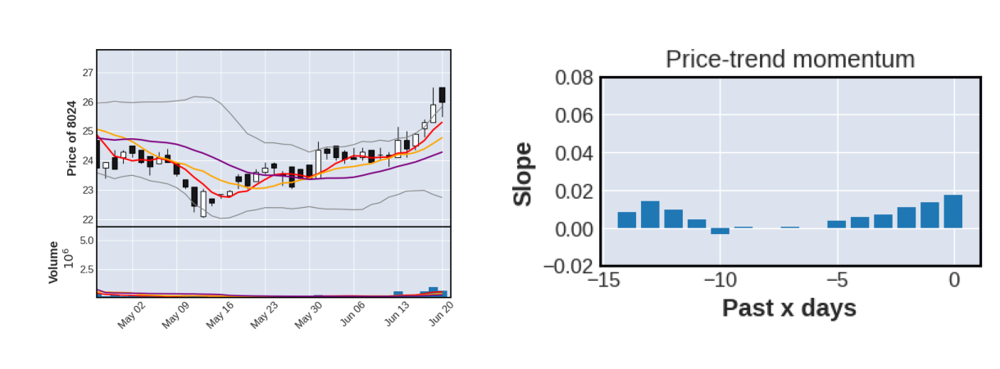

In [ ]:
display_analysis(growth[5], chosen_data, detail_dict)

## High potential: Slope continuously growing
- Depends on the given slope. A slope of 0.02 is quite a strict requirement.


In [ ]:
# Change chosen_data to quickly change the analysed target stock lists
chosen_data = tw_dict

slope = {3: [],
         5: [],
         10: [],
         15: []}

for k in chosen_data.keys():
  slp = np.where(chosen_data[k][-20:]["slope"] > 0.02, 1, 0)

  # Limit price to below 400k
  if chosen_data[k].iloc[-1]["Close"] < 400:
    # Save in order so there won't be duplicates
    if sum(slp[-15:]) == 15:
      slope[15].append(k)
    elif sum(slp[-10:]) == 10:
      slope[10].append(k)
    elif sum(slp[-5:]) == 5:
      slope[5].append(k)
    elif sum(slp[-3:]) == 3:
      slope[3].append(k)

print(len(slope[3]), len(slope[5]), len(slope[10]), len(slope[15]))

31 9 0 0


In [ ]:
final_ranking = add_ranking(slope[3] + slope[5] + slope[10] + slope[15], final_ranking, "slope")

3017, ['奇鋐', 15, 'focus', 'nan']


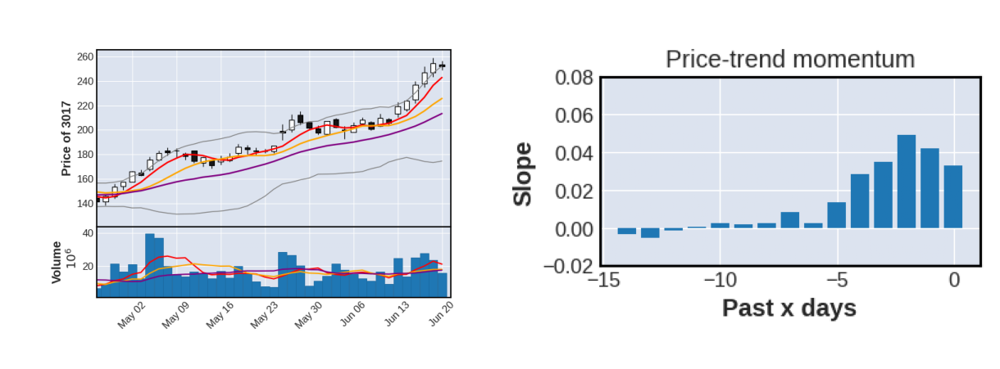

5258, ['虹堡', 53, 'focus', 'nan']


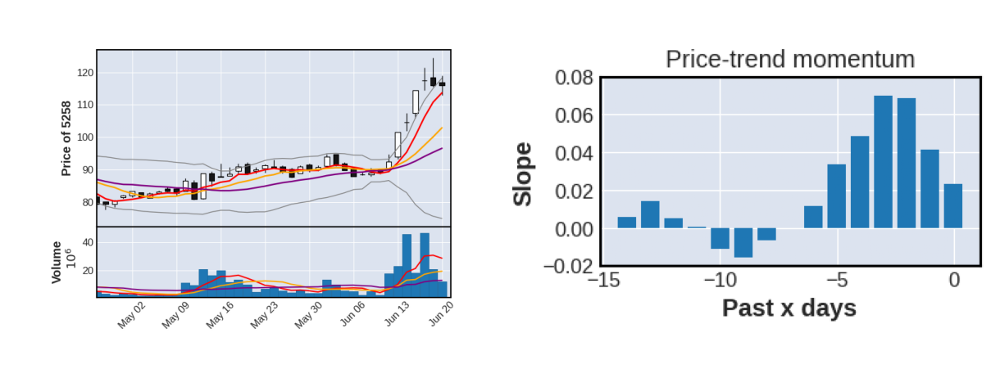

2468, ['華經', 57]


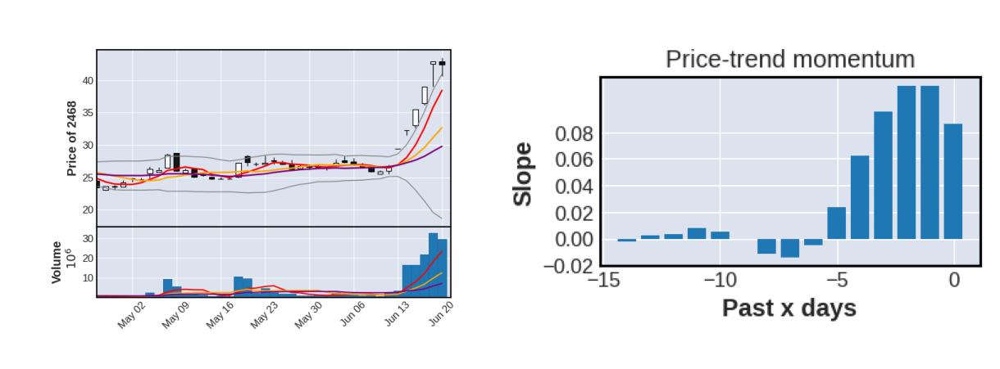

2405, ['輔信', 186]


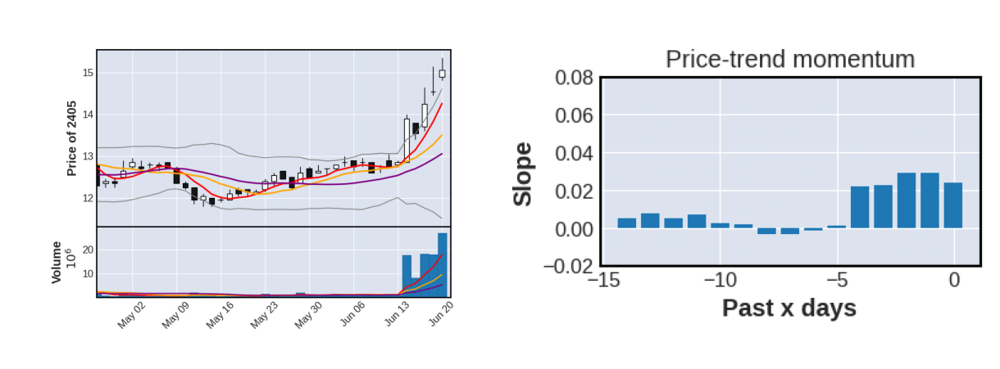

6148, ['驊宏資', 219]


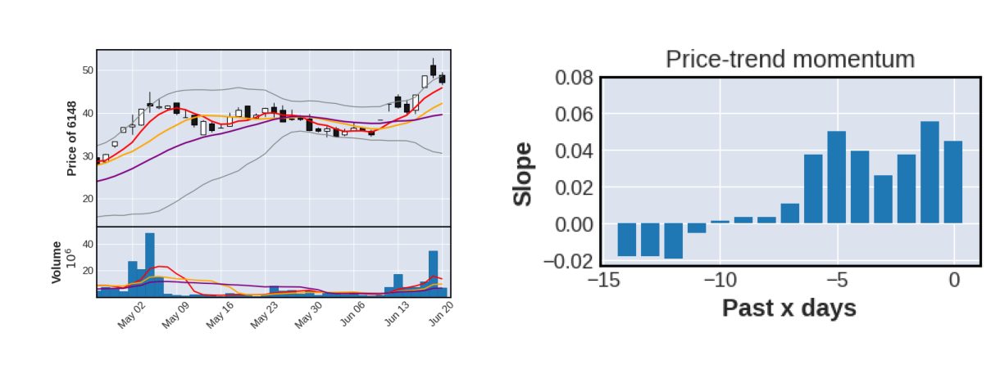

2719, ['燦星旅', 500]


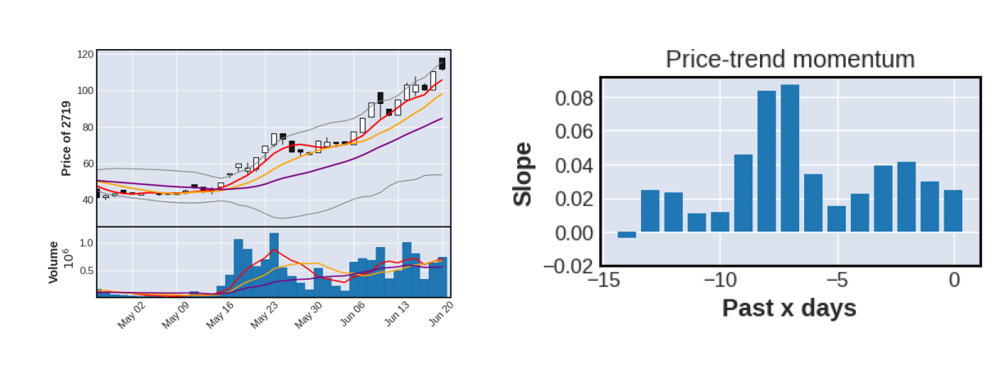

8087, ['華鎂鑫', 581]


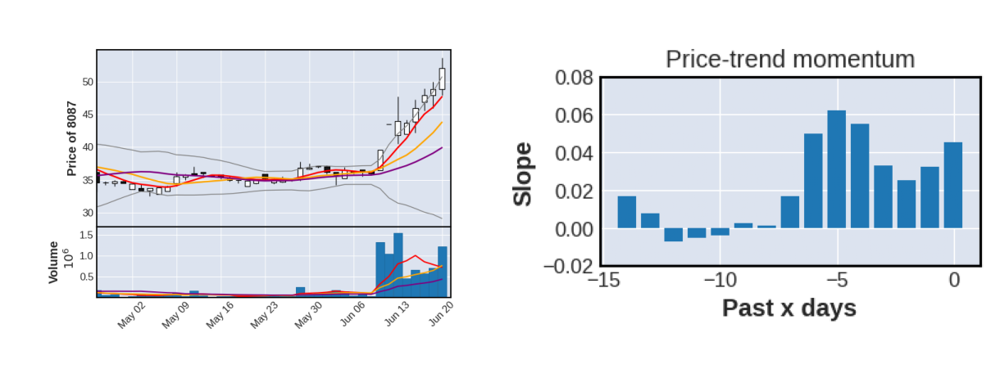

8147, ['正淩', 339]


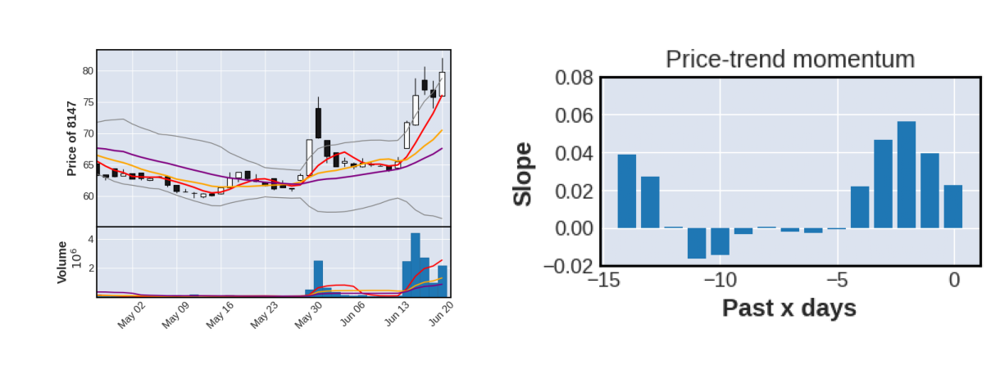

4538, ['大詠城', 633]


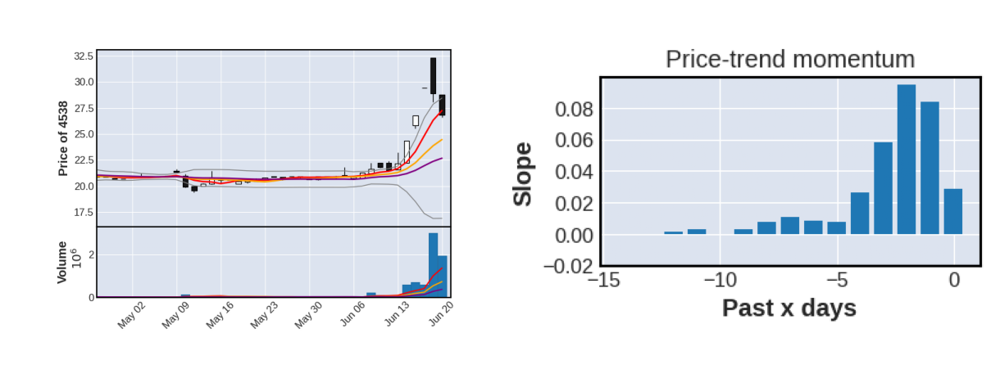

In [ ]:
display_analysis(slope[5], chosen_data, detail_dict)

## Mid potential: Close price > 5ma over certain days
- Use this on full ticker lists to look for potential stocks (russell, s&p500...)
- Not a strict constraint, may show a lot of stock that needs further inspection

In [ ]:
# Change chosen_data to quickly change the analysed target stock lists
chosen_data = tw_dict

ma_5 = {5: [],
        10: [],
        15: []}

for k in chosen_data.keys():
  momentum = np.where(chosen_data[k][-20:]["Close"] > chosen_data[k][-20:]["MA5"], 1, 0)

  # Limit price to below 400k
  if chosen_data[k].iloc[-1]["Close"] < 400:
    # Save in order so there won't be duplicates
    if sum(momentum[-15:]) == 15:
      ma_5[15].append(k)
    elif sum(momentum[-10:]) == 10:
      ma_5[10].append(k)
    elif sum(momentum[-5:]) == 5:
      ma_5[5].append(k)

print(len(ma_5[5]), len(ma_5[10]), len(ma_5[15]))

97 18 9


In [ ]:
final_ranking = add_ranking(ma_5[5] + ma_5[10] + ma_5[15], final_ranking, ">5ma")

2308, ['台達電', 13, 'no', '台達伺服器電源 全球市占過半']


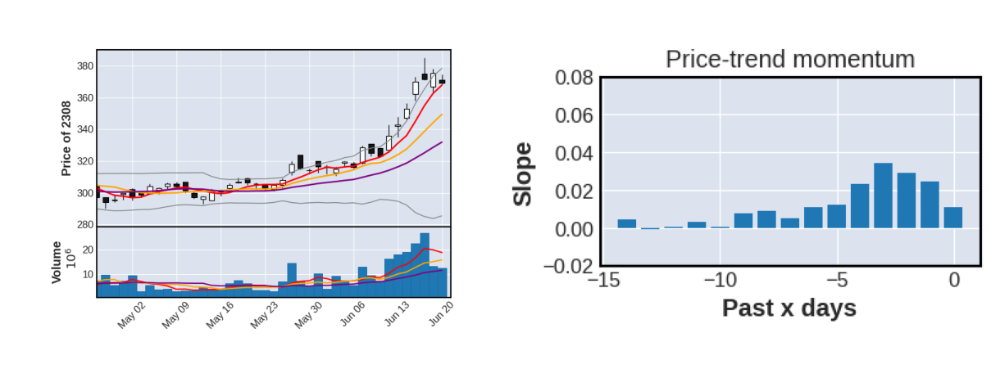

3078, ['僑威', 56, 'focus', 'nan']


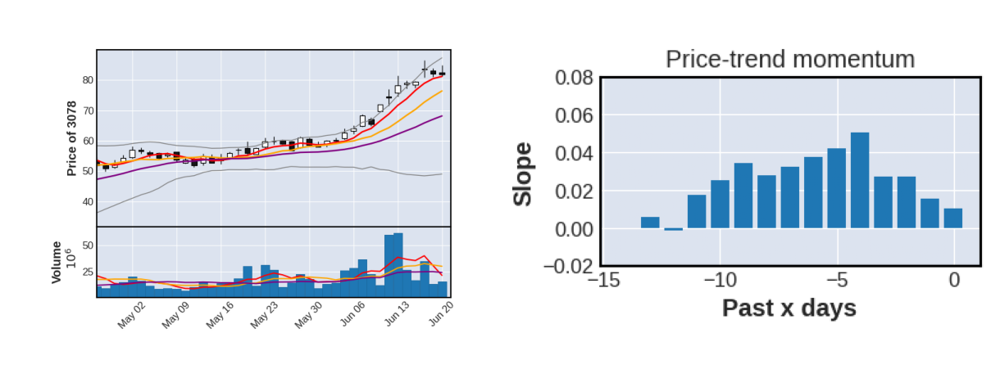

1216, ['統一', 58]


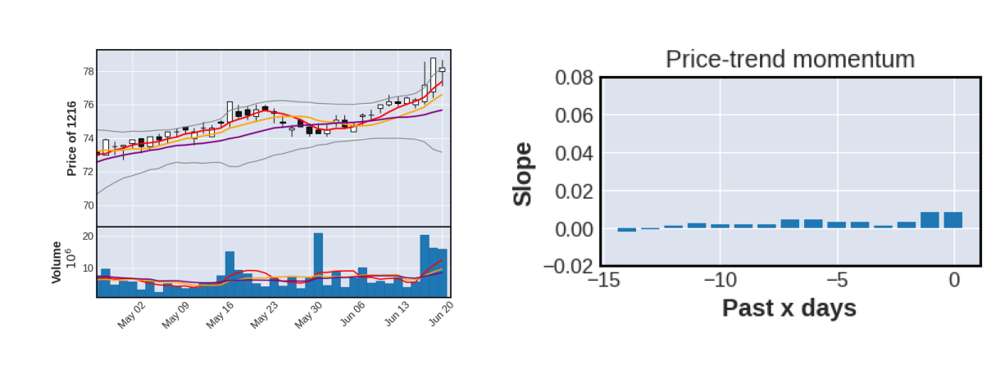

4967, ['十銓', 67]


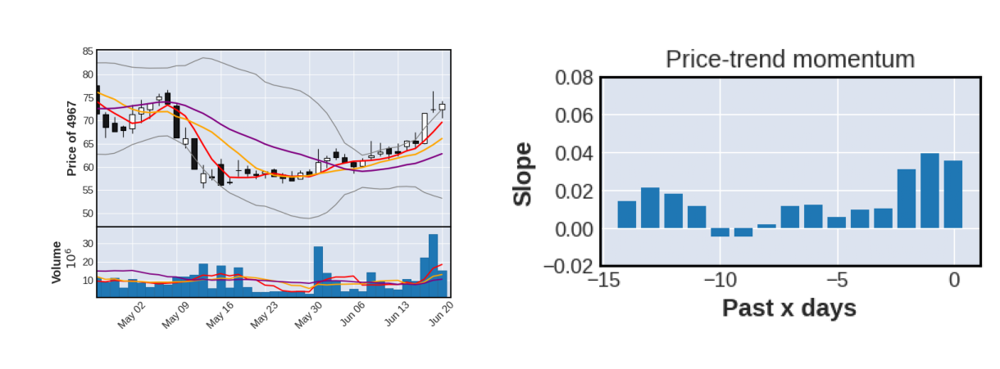

3217, ['優群', 82]


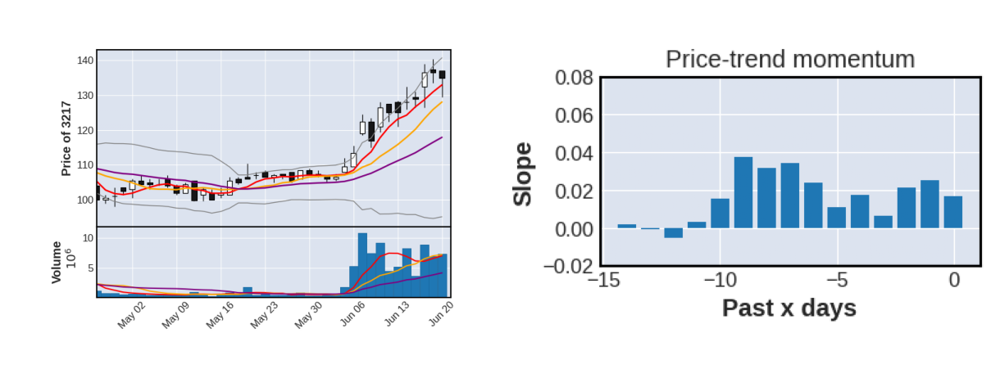

6285, ['啟碁', 125]


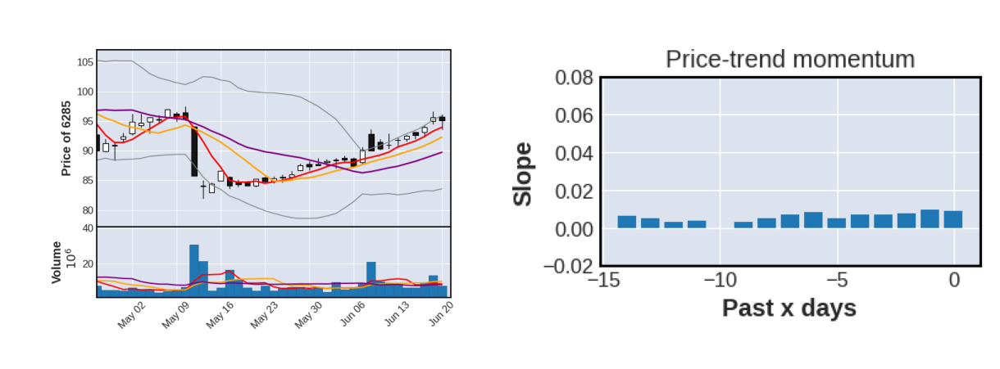

2630, ['亞航', 171]


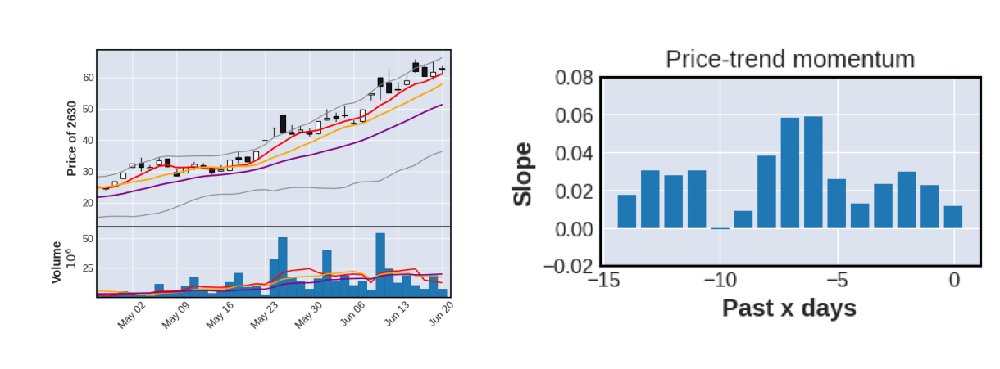

2360, ['致茂', 187]


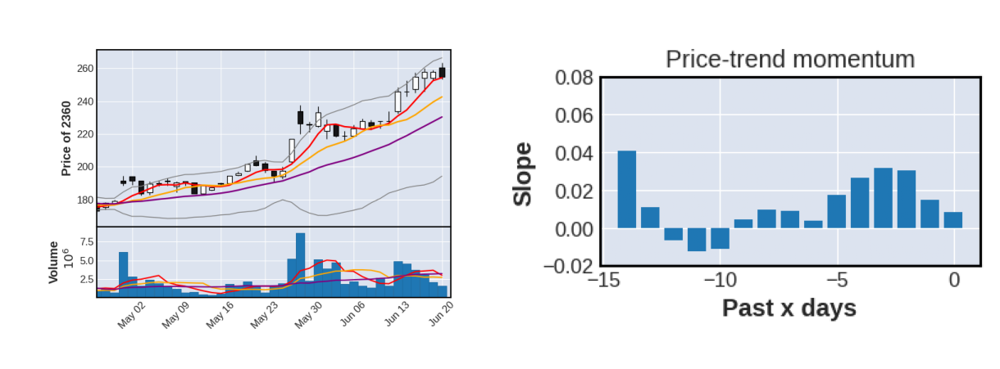

4755, ['三福化', 383]


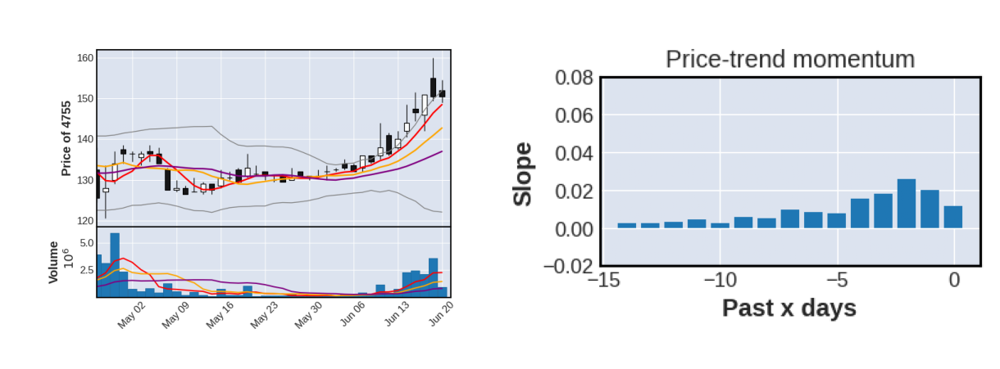

5426, ['振發', 435]


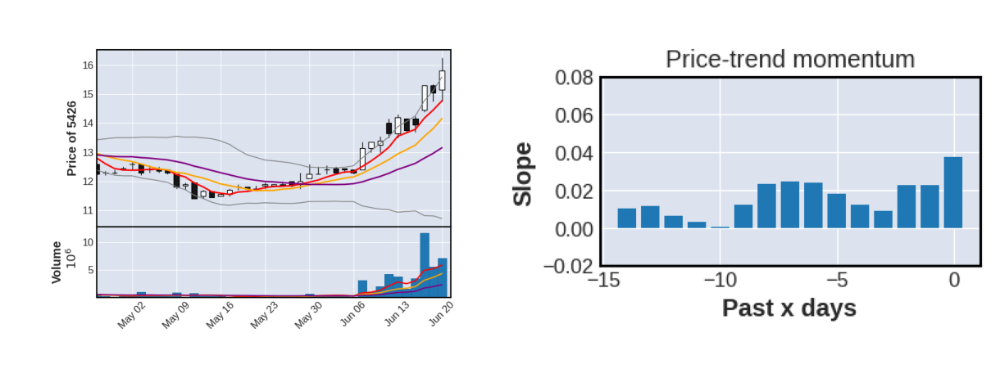

6854, ['錼創科技-KY創', 515]


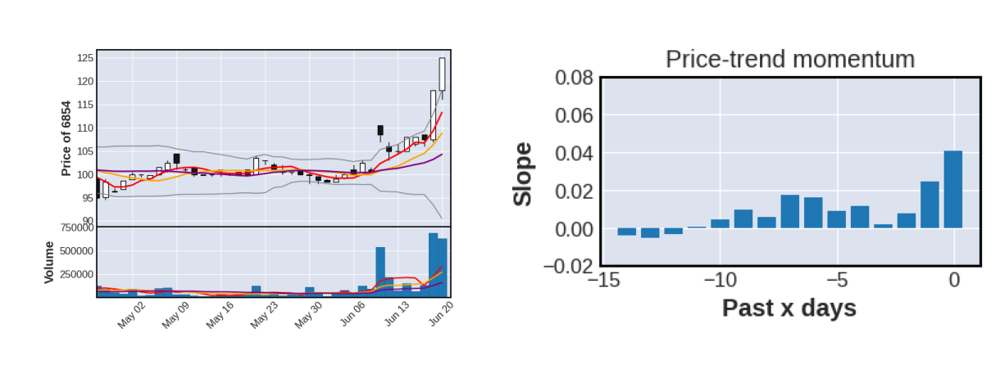

1515, ['力山', 550]


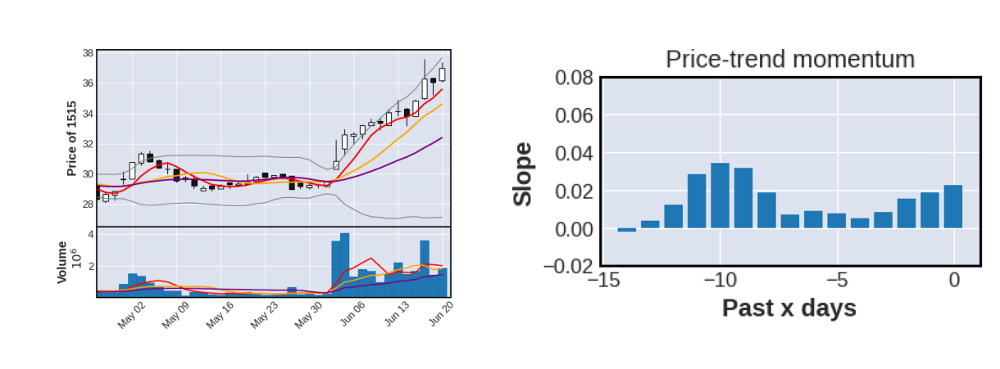

3498, ['陽程', 585]


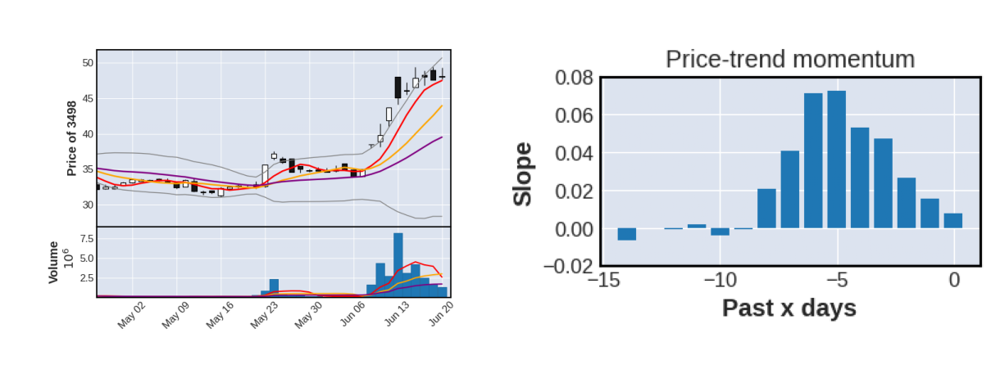

8942, ['森鉅', 653]


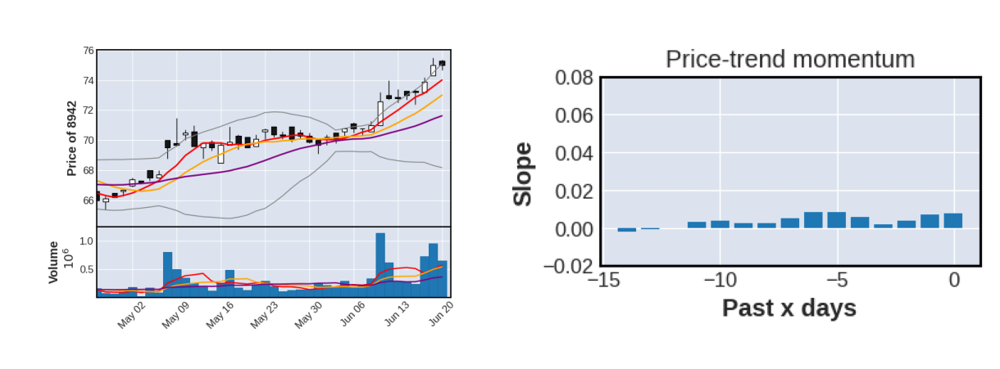

6126, ['信音', 747]


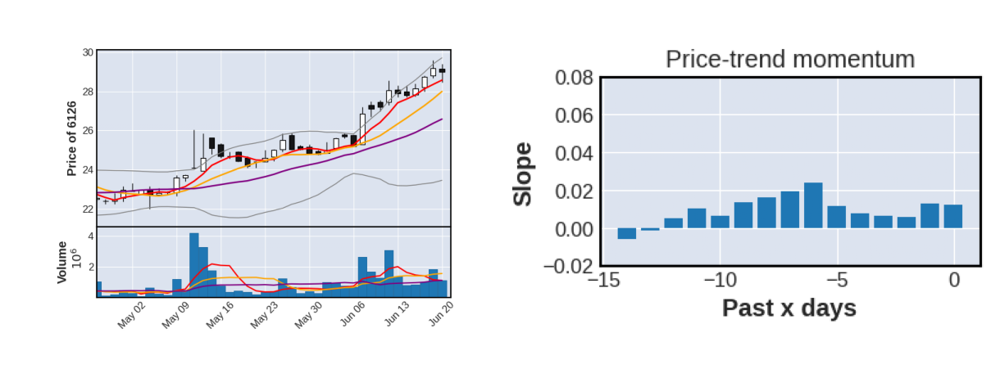

1108, ['幸福', 857]


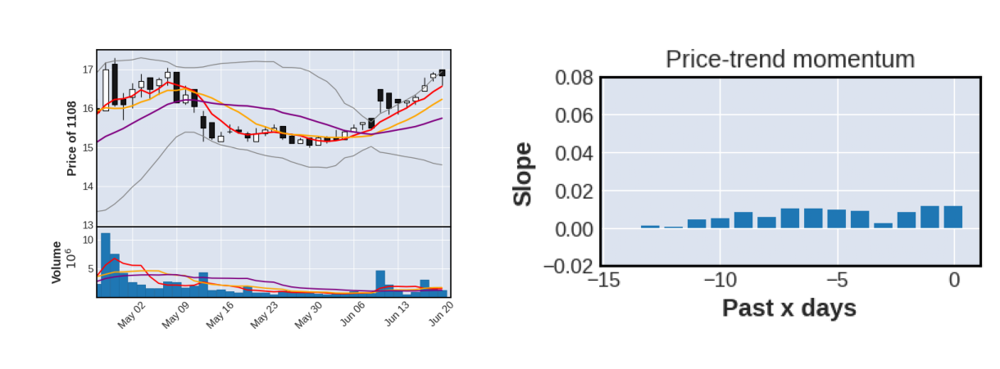

2103, ['台橡', 866]


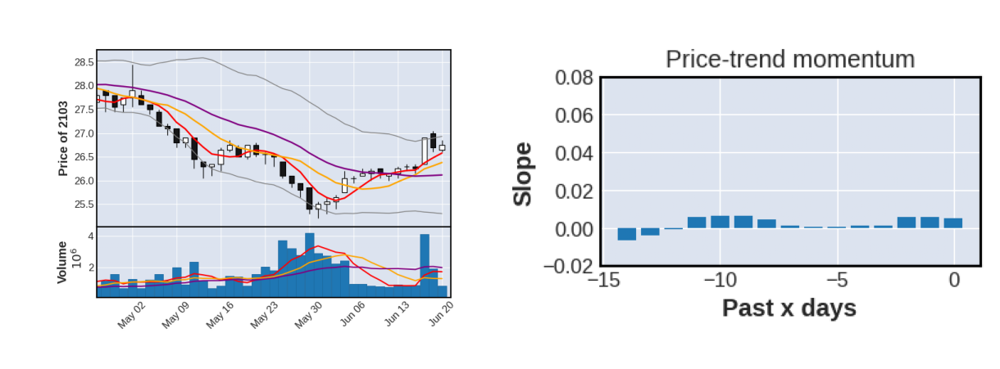

6219, ['富旺', 889]


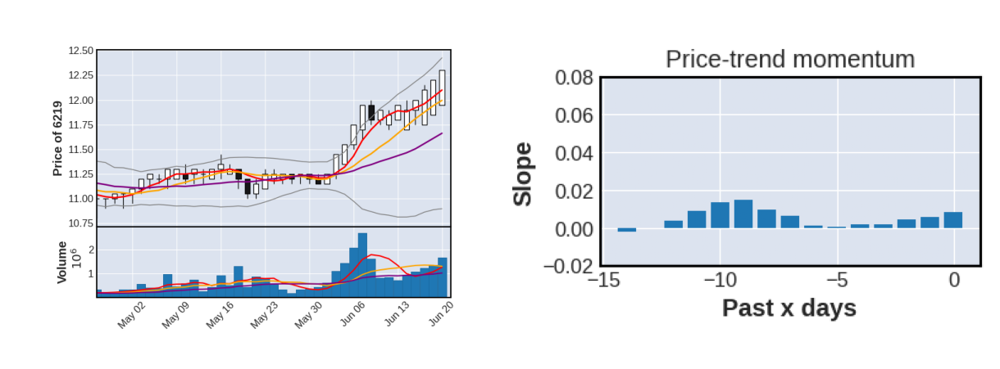

2376, ['技嘉', 10, 'holding', 'nan']


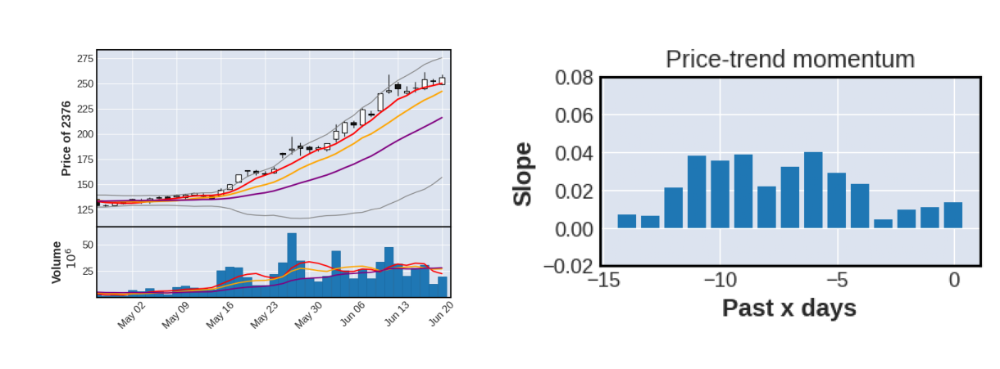

3693, ['營邦', 19]


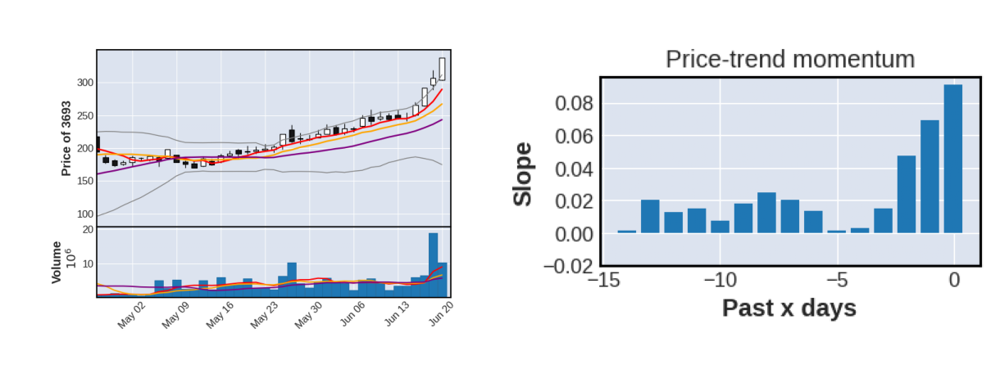

4979, ['華星光', 27]


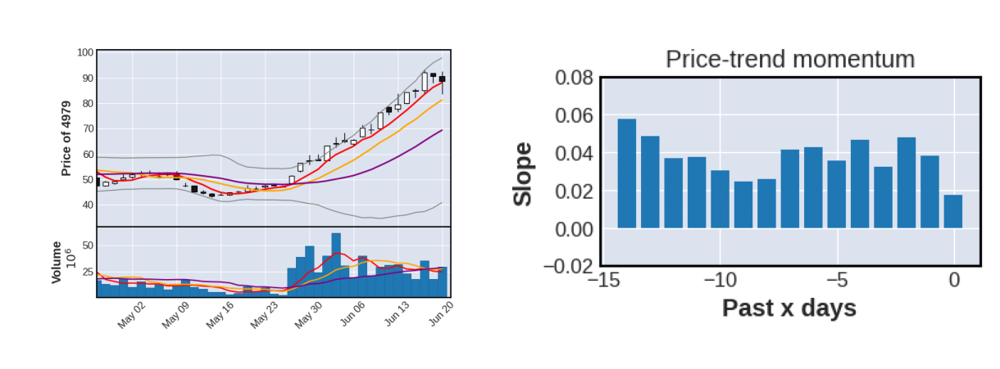

2486, ['一詮', 209]


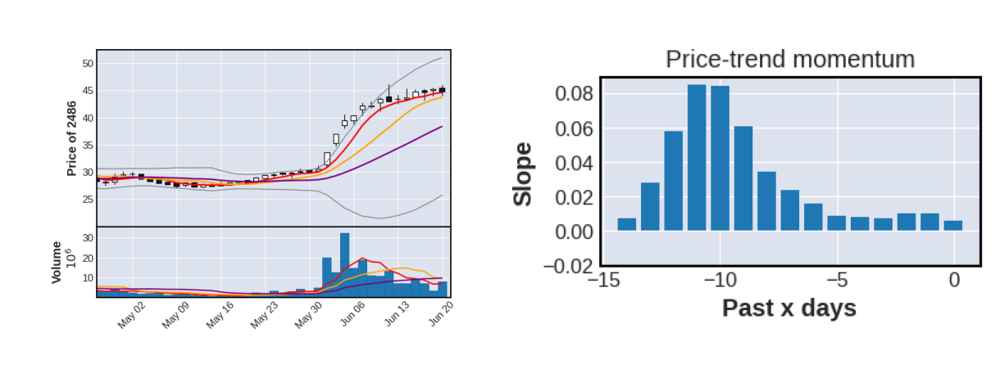

2211, ['長榮鋼', 255]


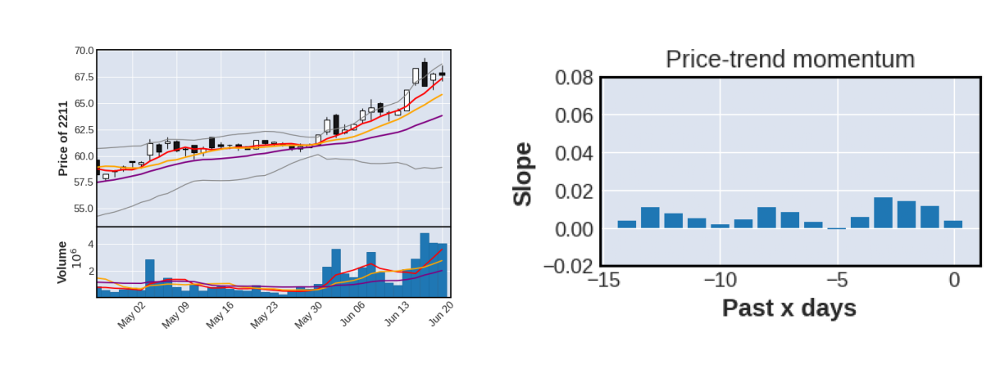

6266, ['泰詠', 256]


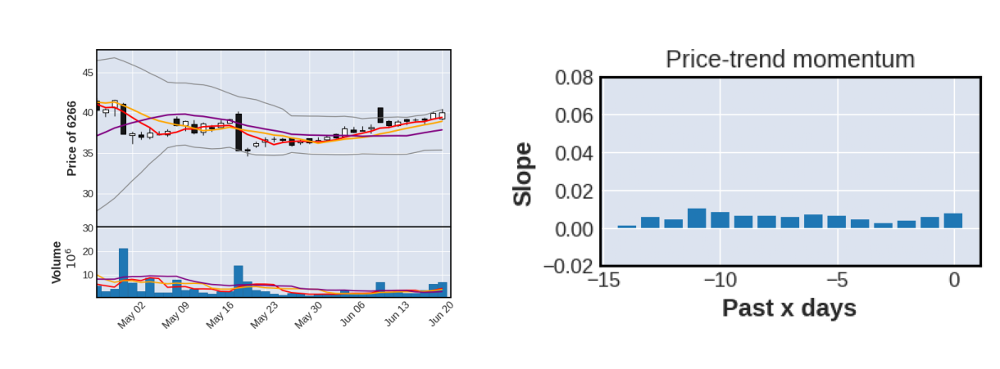

6125, ['廣運', 330]


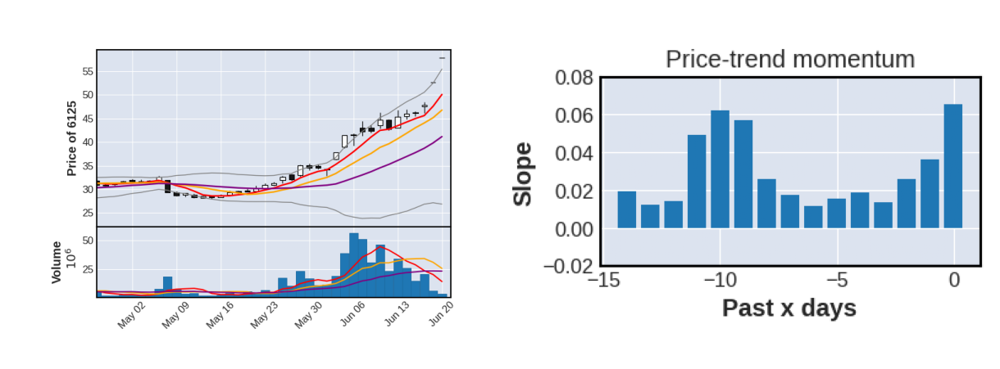

1603, ['華電', 681]


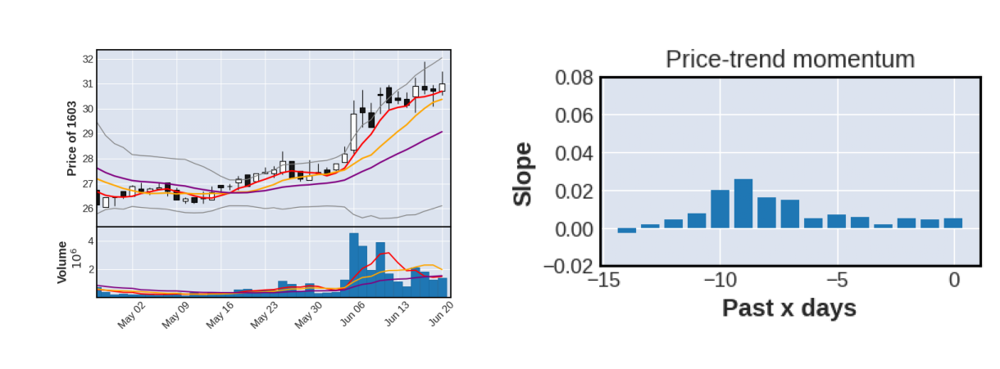

8349, ['恒耀', 820]


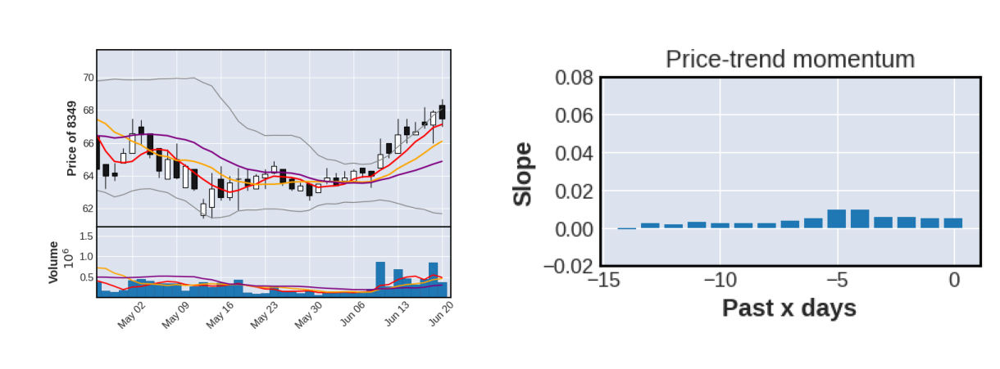

In [ ]:
display_analysis(ma_5[10] + ma_5[15], chosen_data, detail_dict)

## Mid potential: 5ma > 10ma > 20ma over certain days
- A typical bullish trend

In [ ]:
# Change chosen_data to quickly change the analysed target stock lists
chosen_data = tw_dict

ma_all = {5: [],
          10: [],
          15: []}

for k in chosen_data.keys():
  momentum = np.where(chosen_data[k][-20:]["MA5"] > chosen_data[k][-20:]["MA10"], 1, 0)
  momentum = np.where(chosen_data[k][-20:]["MA10"] > chosen_data[k][-20:]["MA20"], momentum, 0)

  # Limit price to below 400k
  if chosen_data[k].iloc[-1]["Close"] < 400:
    # Save in order so there won't be duplicates
    if sum(momentum[-15:]) == 15:
      ma_all[15].append(k)
    elif sum(momentum[-10:]) == 10:
      ma_all[10].append(k)
    elif sum(momentum[-5:]) == 5:
      ma_all[5].append(k)

print(len(ma_all[5]), len(ma_all[10]), len(ma_all[15]))

83 94 123


In [ ]:
# there should be a lot tickers that matches, so there is not meaning plotting them all out

In [ ]:
final_ranking = add_ranking(ma_all[5] + ma_all[10] + ma_all[15], final_ranking, "ma 5>10>20")

# Examine the final ranking

In [ ]:
final_ranking = {key: val for key, val in final_ranking.items() if len(val) > 1}


In [ ]:
worth_analysis = {}
for key, val in final_ranking.items():
  if len(val) >= 3:
    print(key, val, detail_dict[key])
    worth_analysis.update({key: [val, detail_dict[key]]})

6120 ['volume', 'slope', '>5ma', 'ma 5>10>20'] ['達運', 155]
4747 ['volume', '10ma up', 'slope'] ['強生', 208]
6462 ['volume', '>5ma', 'ma 5>10>20'] ['神盾', 178]
1471 ['volume', '>5ma', 'ma 5>10>20'] ['首利', 363]
4549 ['volume', '>5ma', 'ma 5>10>20'] ['桓達', 344]
2371 ['volume', 'slope', '>5ma'] ['大同', 6, 'focus', 'nan']
6854 ['volume', '>5ma', 'ma 5>10>20'] ['錼創科技-KY創', 515]
8210 ['10ma up', 'slope', '>5ma', 'ma 5>10>20'] ['勤誠', 36]
5465 ['10ma up', '>5ma', 'ma 5>10>20'] ['富驊', 68, 'focus', '新品明年Q1出貨']
2630 ['10ma up', '>5ma', 'ma 5>10>20'] ['亞航', 171]
2405 ['10ma up', 'slope', '>5ma', 'ma 5>10>20'] ['輔信', 186]
3356 ['10ma up', '>5ma', 'ma 5>10>20'] ['奇偶', 293]
6125 ['10ma up', 'slope', '>5ma', 'ma 5>10>20'] ['廣運', 330]
8936 ['10ma up', '>5ma', 'ma 5>10>20'] ['國統', 362]
3693 ['10ma up', 'slope', '>5ma', 'ma 5>10>20'] ['營邦', 19]
2722 ['10ma up', 'slope', '>5ma', 'ma 5>10>20'] ['夏都', 117]
1103 ['10ma up', '>5ma', 'ma 5>10>20'] ['嘉泥', 238]
2236 ['10ma up', 'slope', 'ma 5>10>20'] ['百達-KY', 647]


6120, [['volume', 'slope', '>5ma', 'ma 5>10>20'], ['達運', 155]]


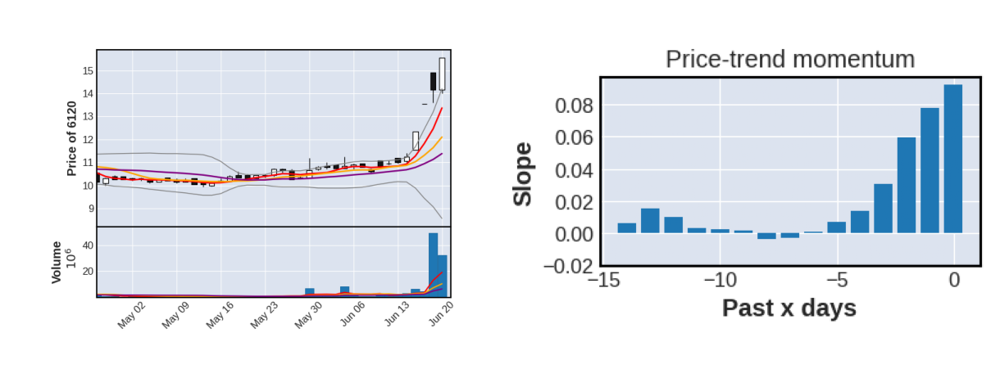

4747, [['volume', '10ma up', 'slope'], ['強生', 208]]


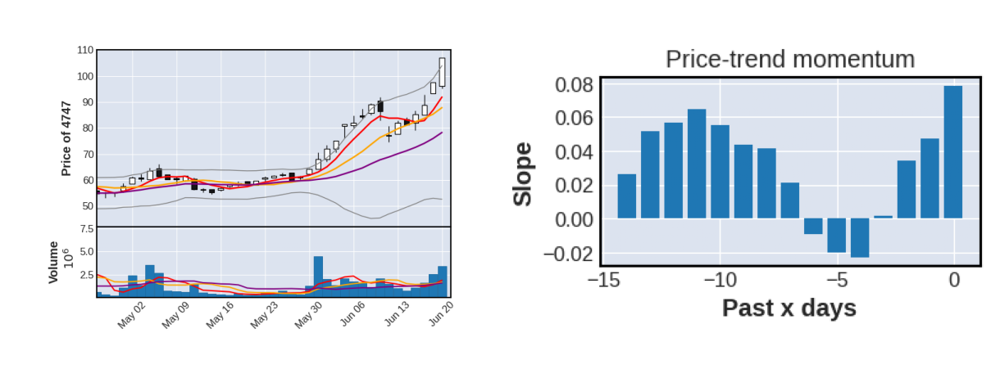

6462, [['volume', '>5ma', 'ma 5>10>20'], ['神盾', 178]]


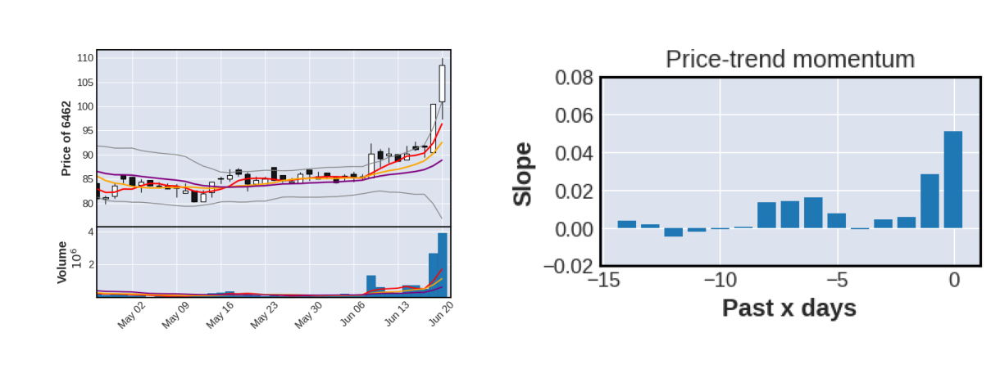

1471, [['volume', '>5ma', 'ma 5>10>20'], ['首利', 363]]


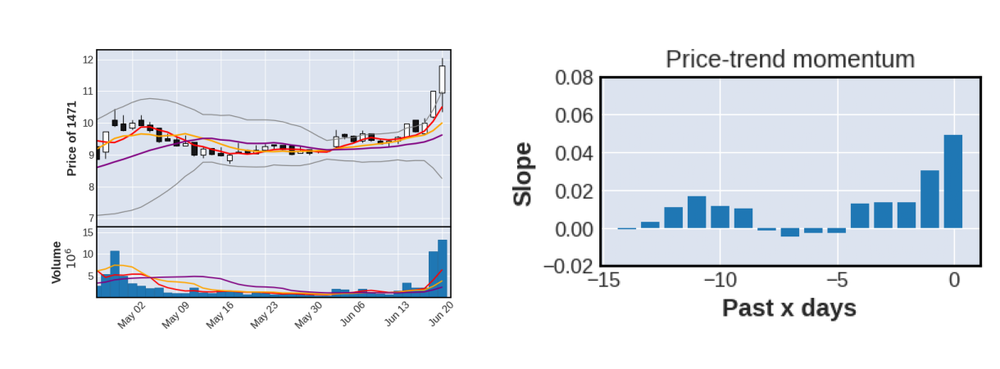

4549, [['volume', '>5ma', 'ma 5>10>20'], ['桓達', 344]]


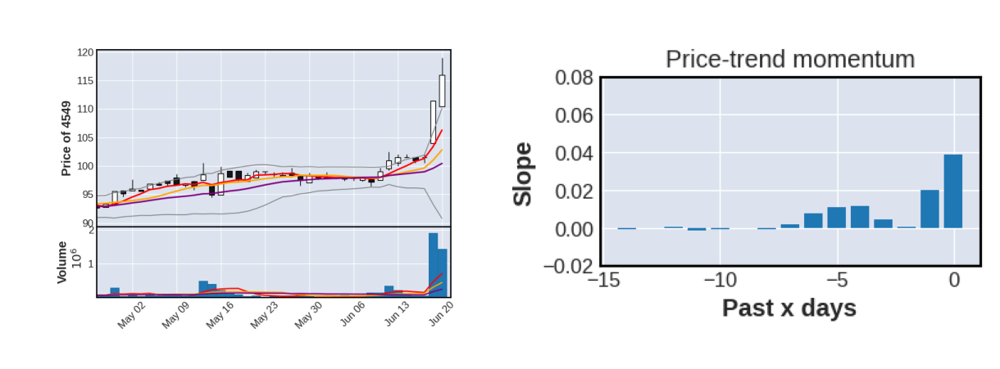

2371, [['volume', 'slope', '>5ma'], ['大同', 6, 'focus', 'nan']]


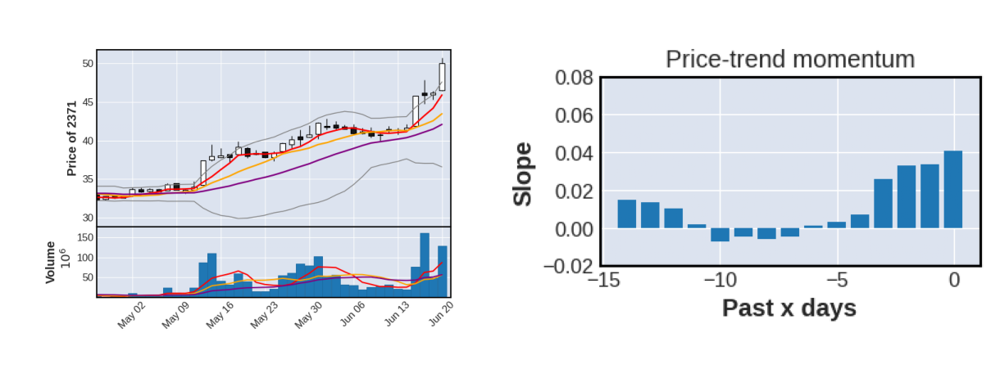

6854, [['volume', '>5ma', 'ma 5>10>20'], ['錼創科技-KY創', 515]]


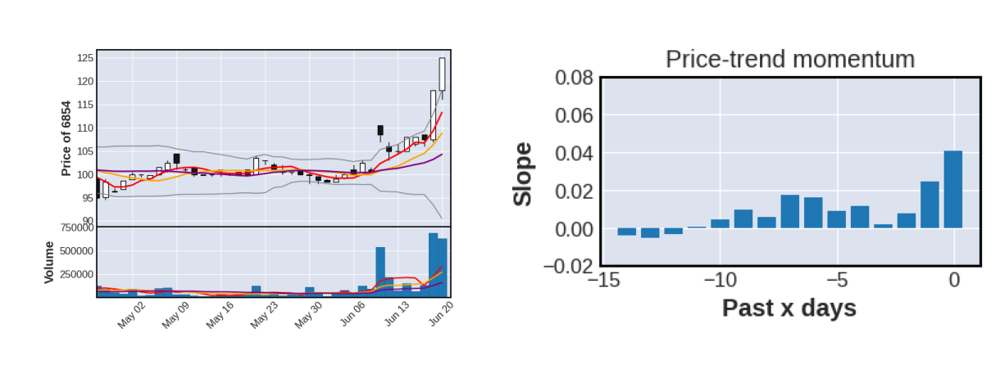

8210, [['10ma up', 'slope', '>5ma', 'ma 5>10>20'], ['勤誠', 36]]


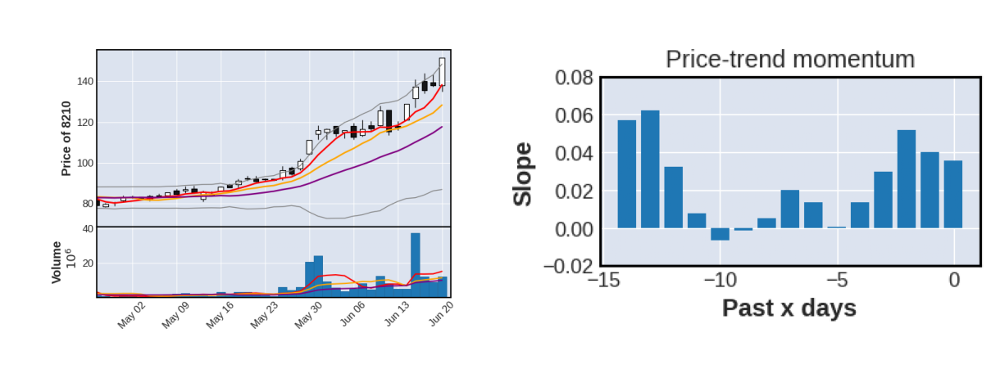

5465, [['10ma up', '>5ma', 'ma 5>10>20'], ['富驊', 68, 'focus', '新品明年Q1出貨']]


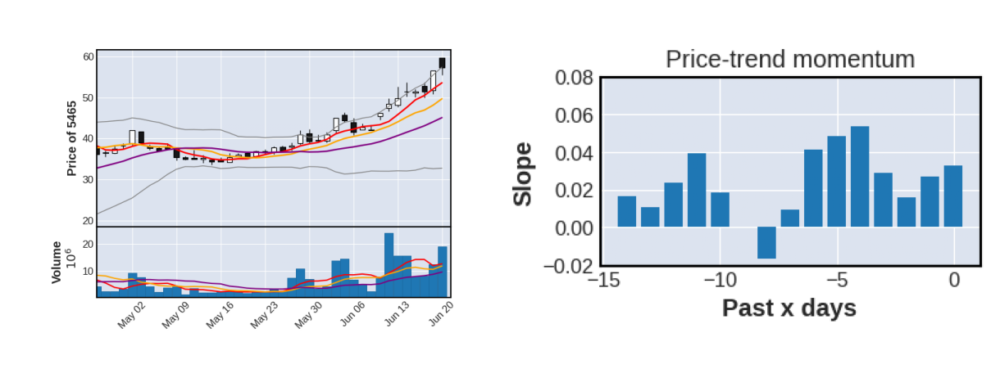

2630, [['10ma up', '>5ma', 'ma 5>10>20'], ['亞航', 171]]


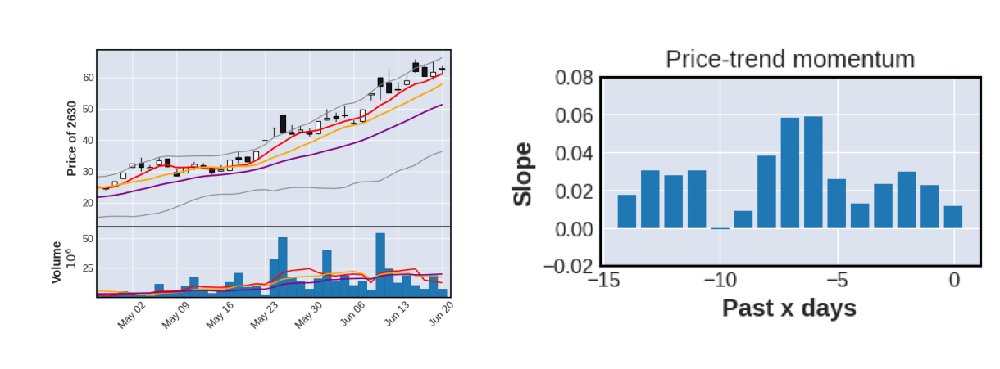

2405, [['10ma up', 'slope', '>5ma', 'ma 5>10>20'], ['輔信', 186]]


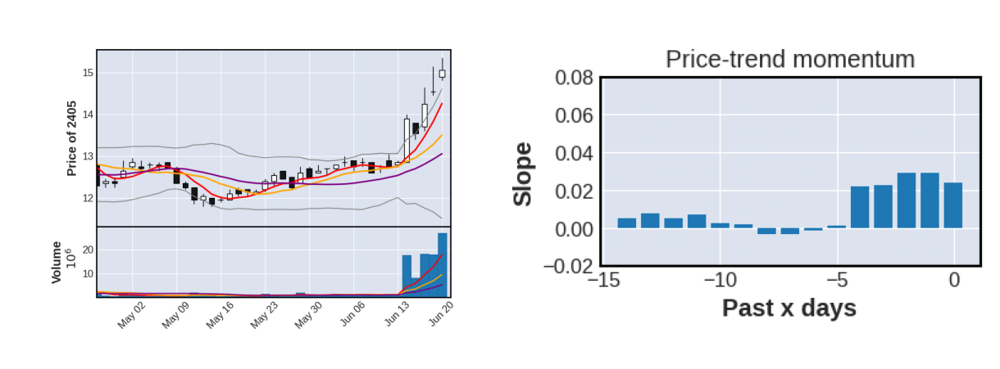

3356, [['10ma up', '>5ma', 'ma 5>10>20'], ['奇偶', 293]]


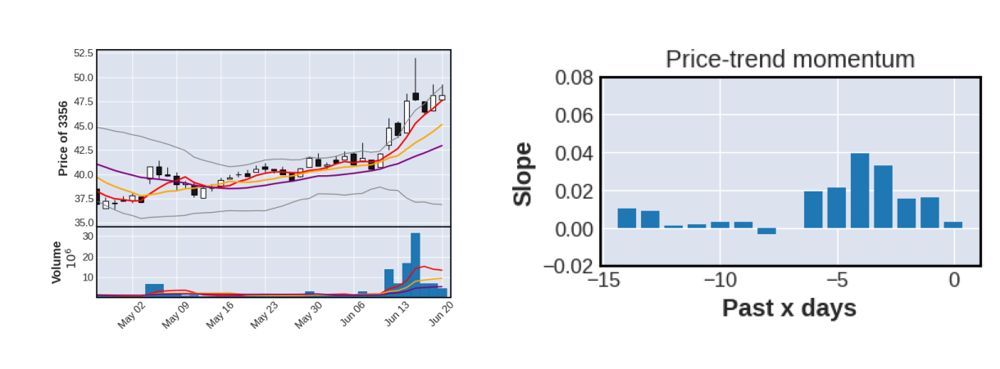

6125, [['10ma up', 'slope', '>5ma', 'ma 5>10>20'], ['廣運', 330]]


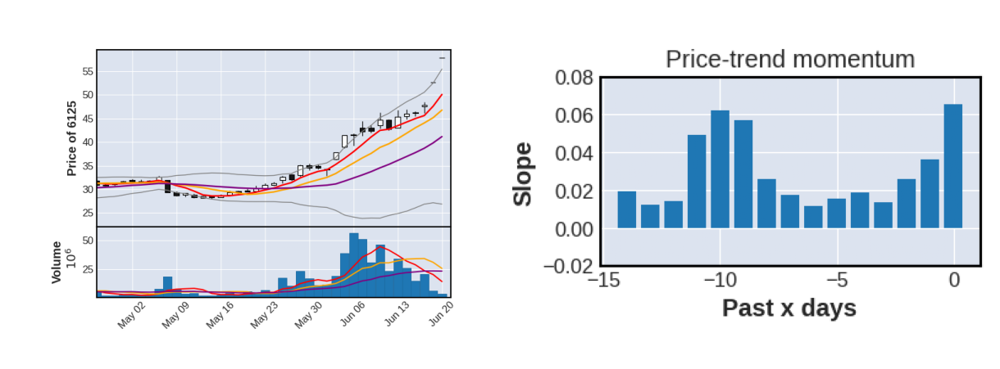

8936, [['10ma up', '>5ma', 'ma 5>10>20'], ['國統', 362]]


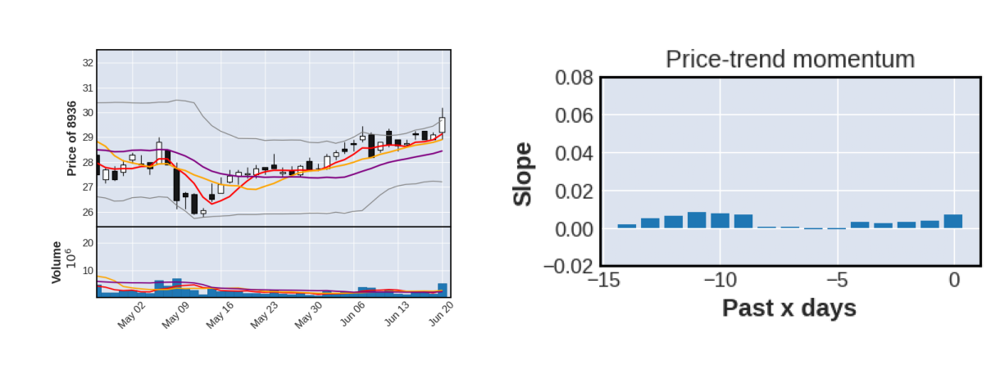

3693, [['10ma up', 'slope', '>5ma', 'ma 5>10>20'], ['營邦', 19]]


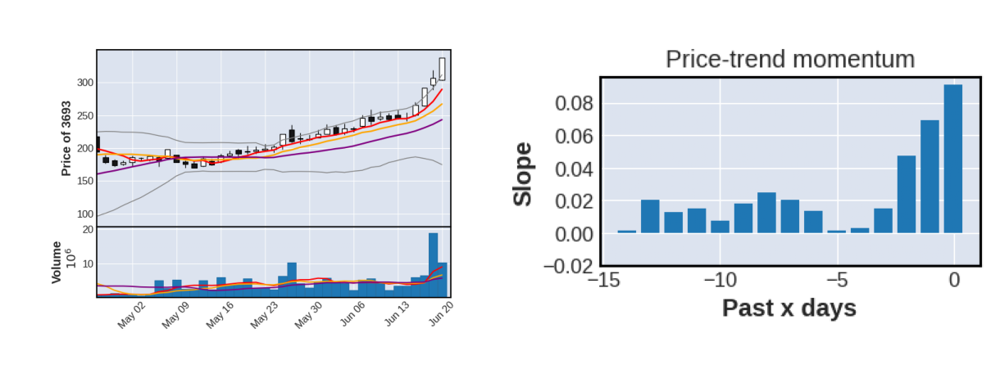

2722, [['10ma up', 'slope', '>5ma', 'ma 5>10>20'], ['夏都', 117]]


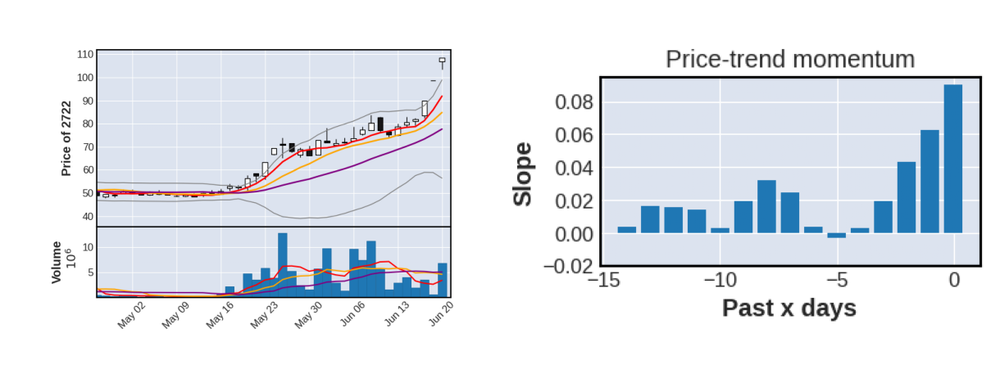

1103, [['10ma up', '>5ma', 'ma 5>10>20'], ['嘉泥', 238]]


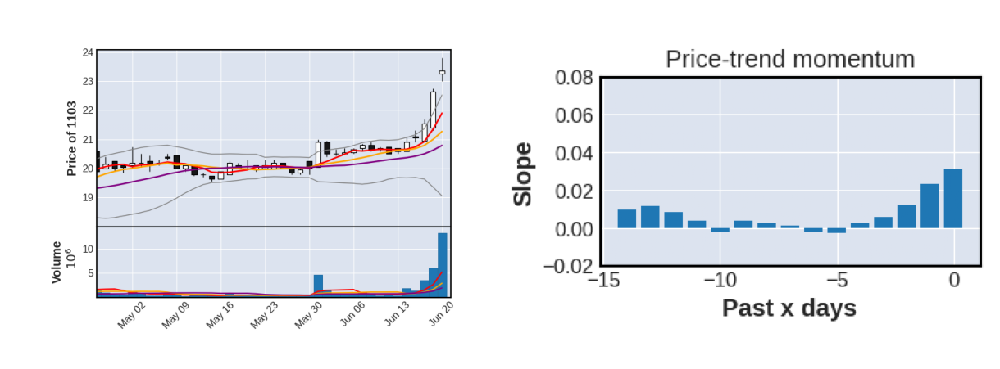

2236, [['10ma up', 'slope', 'ma 5>10>20'], ['百達-KY', 647]]


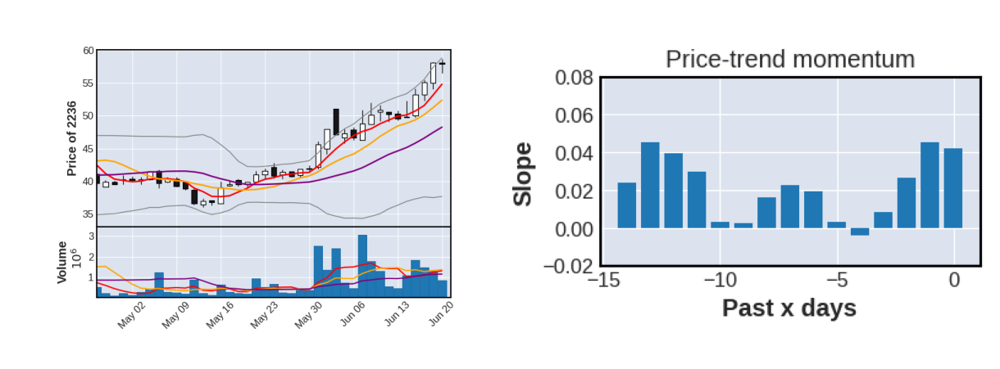

8024, [['10ma up', '>5ma', 'ma 5>10>20'], ['佑華', 974]]


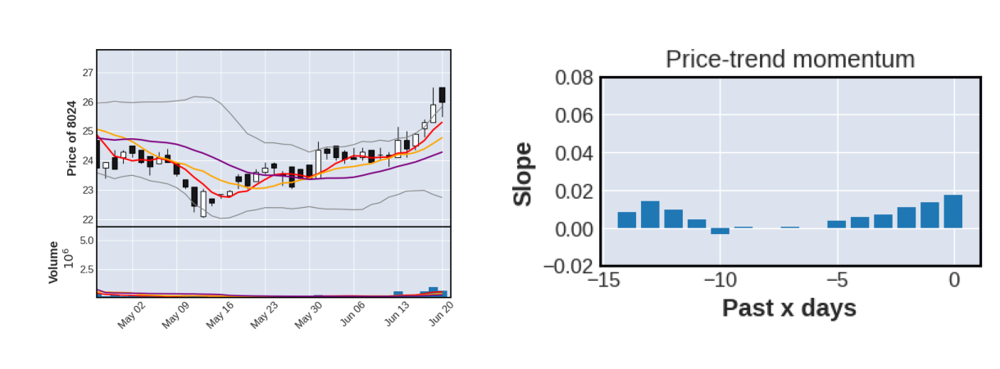

2610, [['slope', '>5ma', 'ma 5>10>20'], ['華航', 12]]


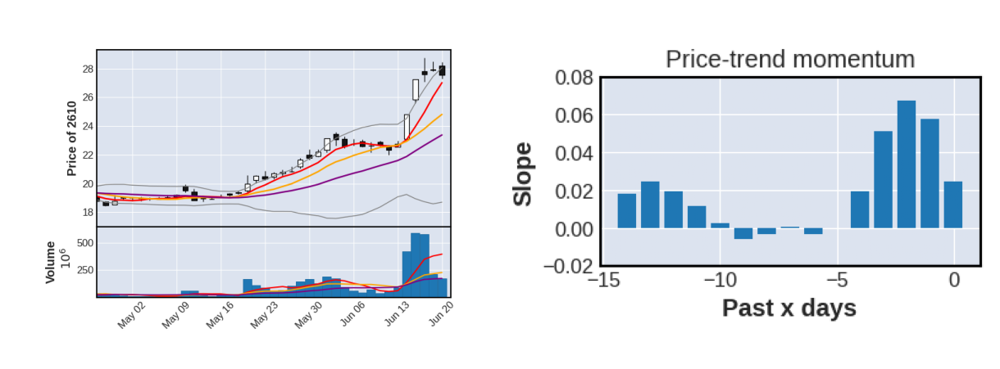

1477, [['slope', '>5ma', 'ma 5>10>20'], ['聚陽', 24]]


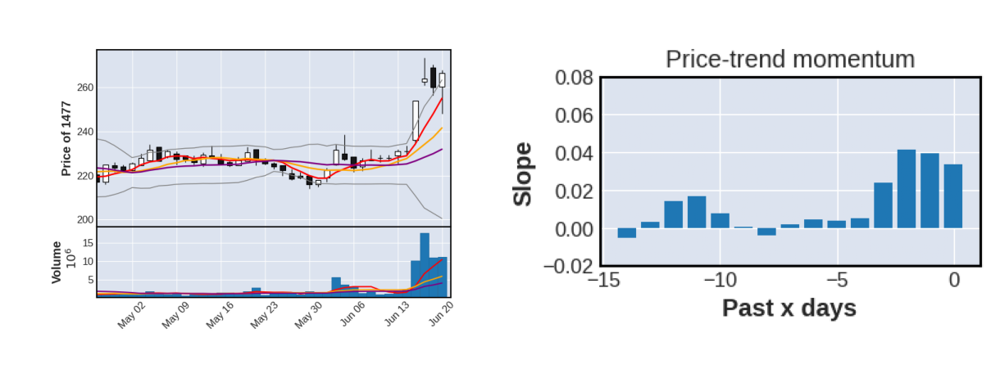

4967, [['slope', '>5ma', 'ma 5>10>20'], ['十銓', 67]]


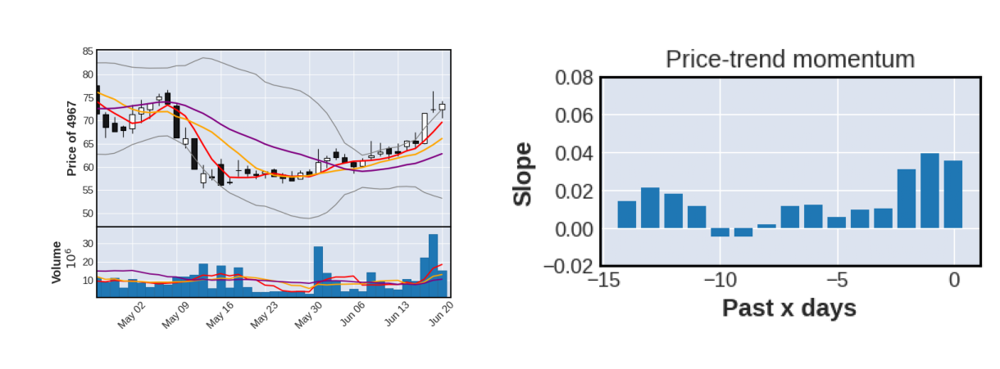

1528, [['slope', '>5ma', 'ma 5>10>20'], ['恩德', 107]]


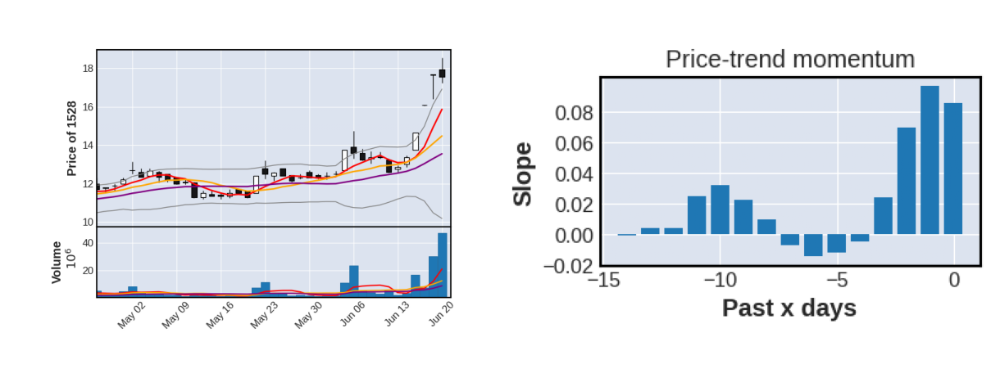

3325, [['slope', '>5ma', 'ma 5>10>20'], ['旭品', 172]]


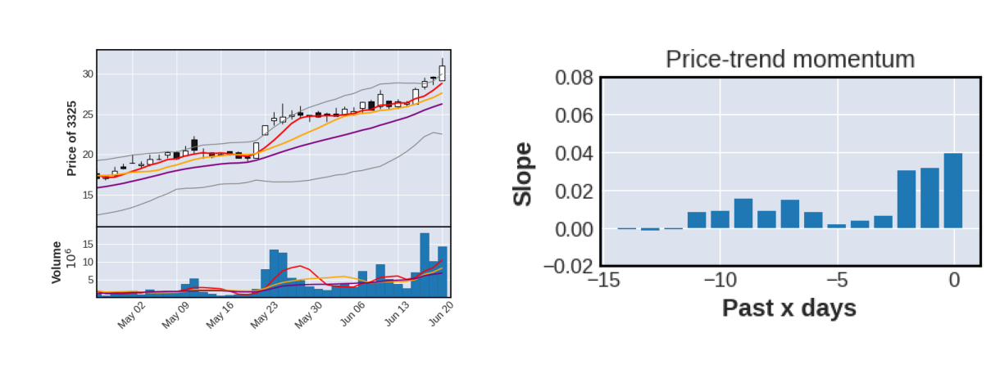

5426, [['slope', '>5ma', 'ma 5>10>20'], ['振發', 435]]


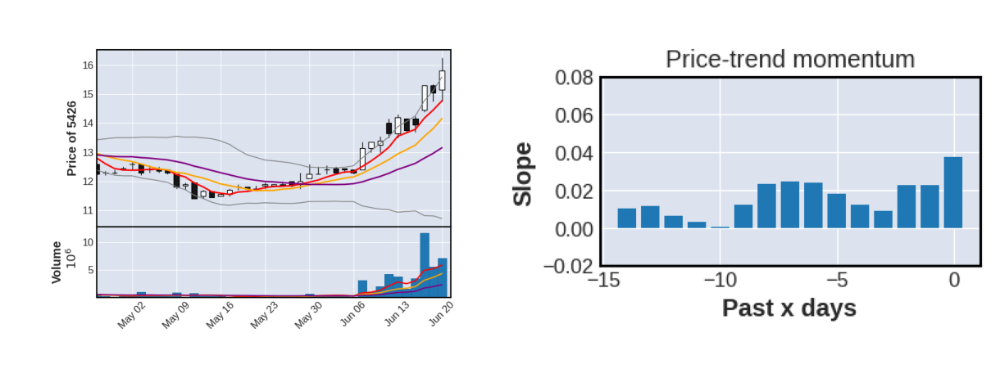

3213, [['slope', '>5ma', 'ma 5>10>20'], ['茂訊', 599]]


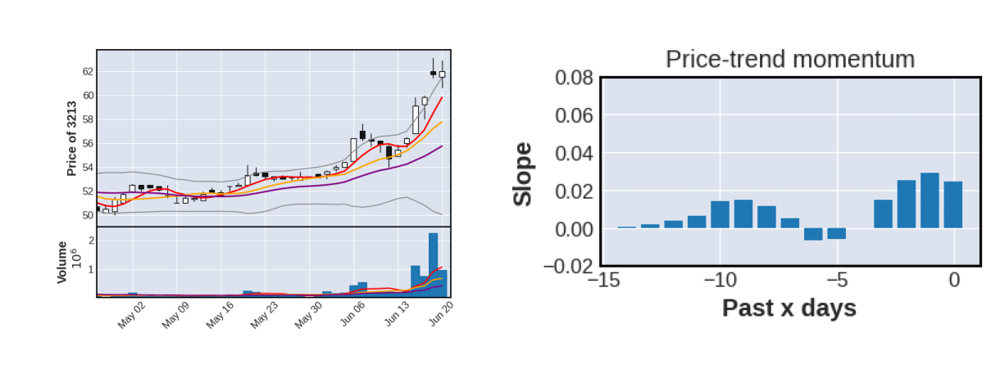

4951, [['slope', '>5ma', 'ma 5>10>20'], ['精拓科', 675]]


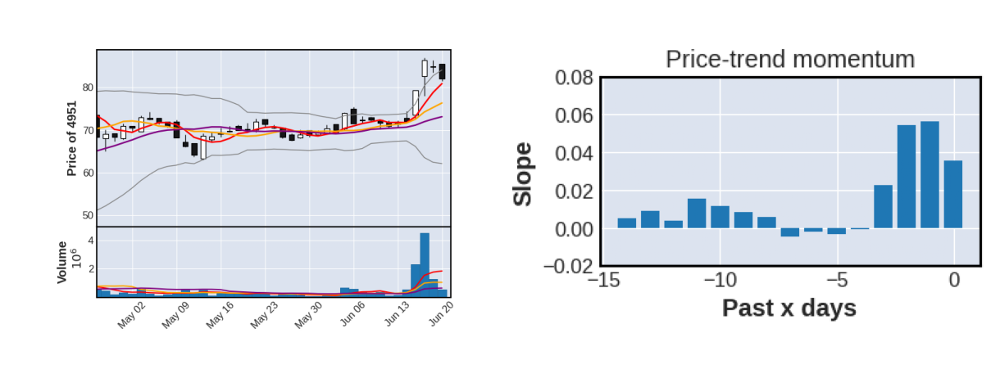

3685, [['slope', '>5ma', 'ma 5>10>20'], ['元創精密', 803]]


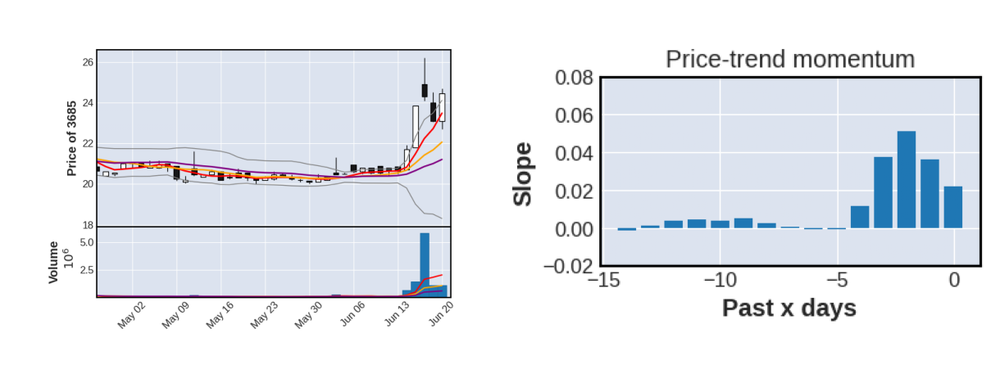

3017, [['slope', '>5ma', 'ma 5>10>20'], ['奇鋐', 15, 'focus', 'nan']]


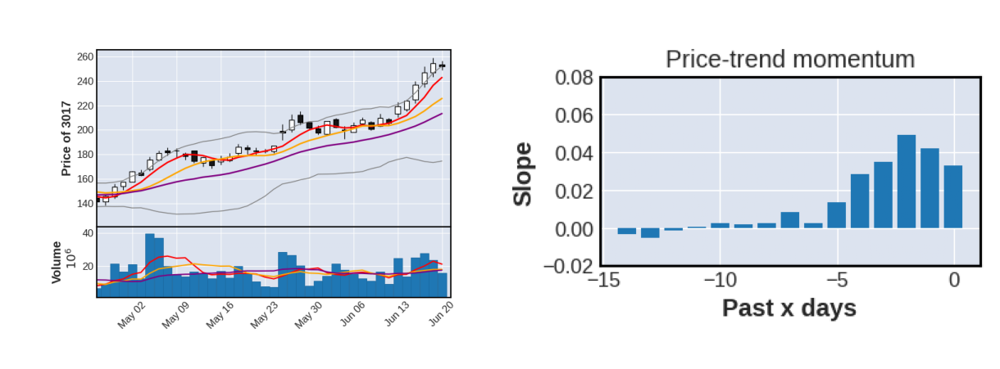

5258, [['slope', '>5ma', 'ma 5>10>20'], ['虹堡', 53, 'focus', 'nan']]


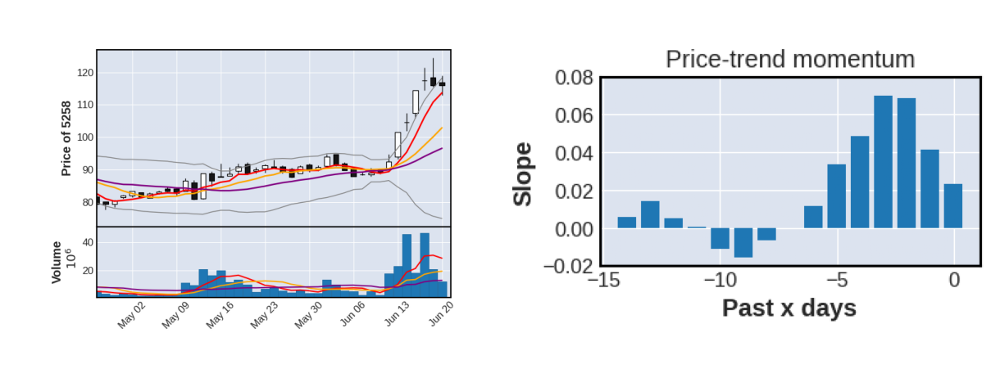

2468, [['slope', '>5ma', 'ma 5>10>20'], ['華經', 57]]


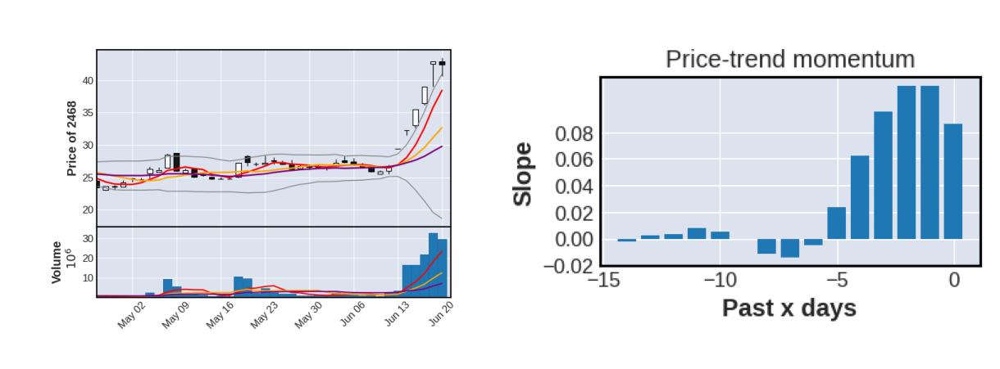

2719, [['slope', '>5ma', 'ma 5>10>20'], ['燦星旅', 500]]


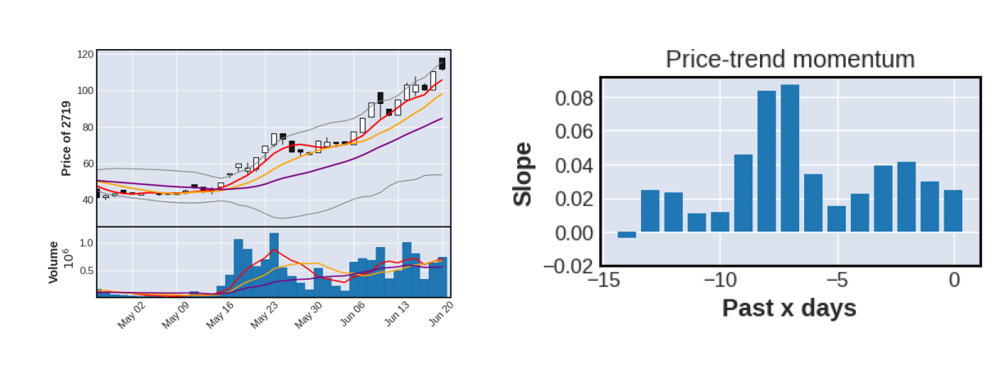

8087, [['slope', '>5ma', 'ma 5>10>20'], ['華鎂鑫', 581]]


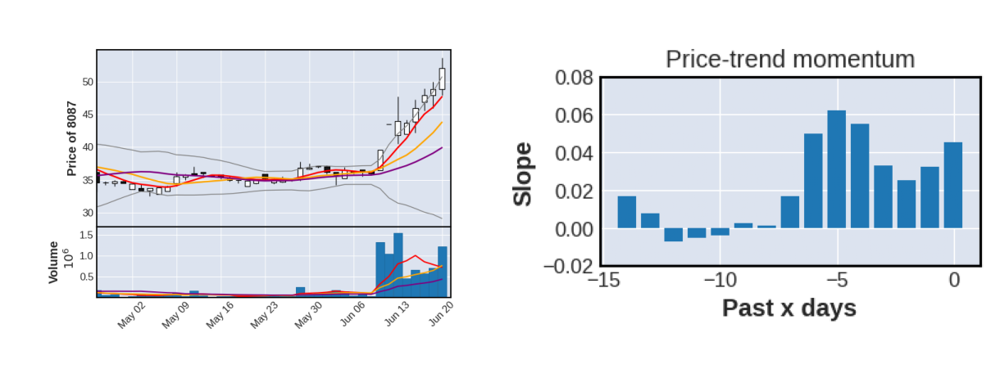

8147, [['slope', '>5ma', 'ma 5>10>20'], ['正淩', 339]]


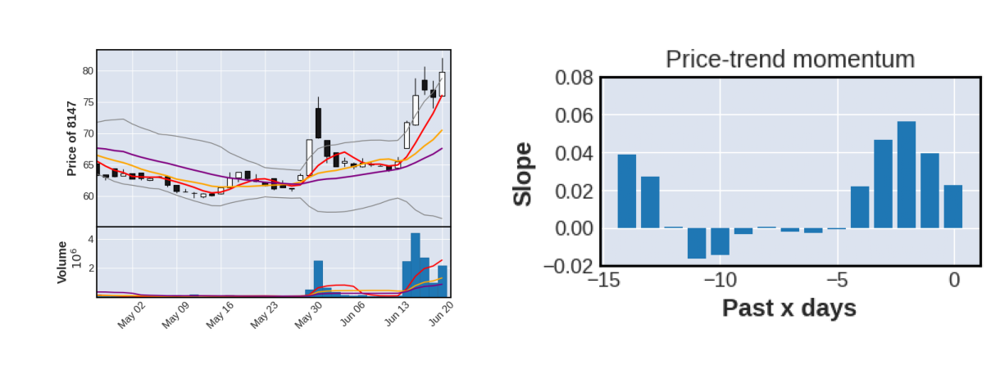

In [ ]:
display_analysis(list(worth_analysis.keys()), chosen_data, worth_analysis)

# Open websites for stock info

In [ ]:
from IPython.display import Javascript, clear_output

def open_web(target):
  for t in target:
    url1 = "https://tw.stock.yahoo.com/quote/" + t + "/news"
    url2 = "https://www.cmoney.tw/forum/stock/" + t[:4]
    display(Javascript('window.open("{url}");'.format(url=url1)))
    display(Javascript('window.open("{url}");'.format(url=url2)))




In [ ]:
# open_web(momentum_15 + momentum_5)


In [ ]:
# Avoid auto-opening webpages every time opening this notebook
# clear_output()